### Introduction to Observability

When you have a distributed system using APIs, it's important to be able to see how different services are operating over time, and react to operational events. We often rely on logs and metrics to help us track down problems and monitoring tools help us collect the data needed to be able to keep a pulse on our systems. In a cloud environment that is ever changing and ever scaling, it's more important than ever to collect various types of data about the systems as they scale up and down and change over time. Monitoring is a verb. It's something we do. We collect metrics. We collect logs. We watch network traffic. When something seems off, automatic alerts go out to someone or something to try to remediate.  
  
In order to keep a good pulse on your system, monitoring is necessary. That being said, monitoring is the act of collecting data. What types of data we collect, what we do with the data, and if that data is readily analyzed or available is a different story. This is where observability comes into play.   
  
Observability is not a verb. It's not something you do. Instead, observability is more of a property of a system. A system can be observable or it can be unobservable. An observable system allows you to measure how well the internal workings of a system are, from the outputs of that system. A system with observability is what you want. If you cannot observe the outputs of your application and know whether things are working well or not, how can you possibly know
whether the changes you are making to your system are working for your end users or not? Outputs from your system can be things like logs, metrics, or other things like distributed tracing. The whole goal here is to shorten the feedback loop. As the pace of innovation in the tech industry accelerates due to things like DevOps culture, CI/CD pipelines, and microservice architectures, there needs to be a way to push a change and know quickly the impact of that change. You have to build components, keeping the idea of observability in mind. A system with observability provides us with the tight feedback loop that we need. One common way to build observability into a system is to use distributed tracing software. Tracing software allows you to understand the flow of traffic through your services. With API-driven applications, you will have services calling each other that together, perform a task. Tracing allows you to collect data on the calls between components
and measure the performance of each individual service and view the system as a whole regarding latency between these services.  
  
Let's think of an example to understand why tracing can be helpful. If I have a microservice application that runs my eCommerce website and my customer is seeing long wait times at checkout, it's probably not good enough for us to wait until the customer sees the slow down, calls us and says, "Hey, your website is slow." So once the customer calls, we know the website is slow and that they are having issues. But where are those issues coming from? Without tracing, we don't really know
which service backing our website is causing the slow down. This sort of reactive troubleshooting can lead to unhappy end users.  
  
So with distributed tracing, you can look at a service map and see the state of the system. You can see the latency for each service as an output of the system. This helps make a system more observable, closing the feedback loop, all good things.   
  
In this next week, we're going to cover how to integrate monitoring, logging, and distributed tracing into our API using AWS services like Amazon CloudWatch and AWS X-Ray.

<pre>


    
</pre>
### Introduction to X-Ray

You've done a great job up to this point in learning about what it takes to build a great modern application. You've not only learned about some of the topics
around building the application itself, but you've also started diving into some of the peripheral concepts, such as security and observability.  
  
Well, I'm here to continue our dive into the later by discussing one of our services that directly assist with the observability of your application workflow. AWS X-Ray.  
  
X-Ray helps you analyze and debug distributed applications, such as those built using a microservices architecture, allowing you to understand how your application
and its underlying services are performing. This level of visibility gives you a way to identify and troubleshoot the root cause of performance issues and errors. X-Ray provides an end-to-end view of requests as they travel through your application. And shows a map of your application's underlying components. You can use it to analyze both applications in development and in production, that can consist of thousands of services within your microservice architecture. But before you start using this, there are several concepts that should be covered so that you can have a solid starting foundation.  
  
First, there are segments. **Segments are the compute resources running your application logic**. These provide the resource's name, details about the request, and details about the work done. Segments can break down the data about the work done into subsegments. Subsegments provide more granular details, such as timing information and downstream calls, made by an application. You can even define subsegments to instrument specific functions or lines of code in your application. For services that don't send their own segments, such as Amazon DynamoDB, X-Ray uses subsegments to generate inferred segments and the downstream nodes on the service map. This lets you see all of your downstream dependencies, even if they don't inherently support X-Ray functionality, or are components external to AWS.  
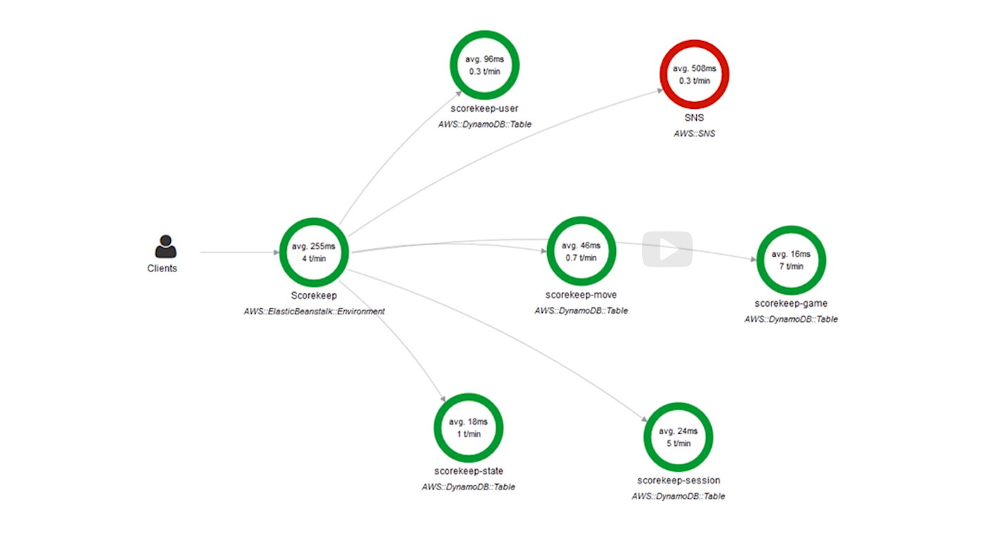
  
The data that your application sends to X-Ray is used to generate a service graph. A service graph is a JSON document that contains information about the services and resources that make up your application. The X-Ray console uses this document to generate a visualization -- what we call a service map.  
  
The final concept I want to cover for now is a trace. A trace is used to track the path of a request through your application. This collects all the segments generated by a single request. As a request progresses through your distributed application, the first supported services will add the trace ID header to the request, and this will be propagated downstream to track the latency, disposition, and other request data.   
  
The way that X-Ray helps you to analyze the application is that it first collects and records the traces, which provides you with a service map to see the trace data, which ultimately allows you to drill into the service or services showing unusual behavior to identify any issues. Currently, if you were to build and run distributed applications, you'd have to rely on a per service or per resource process to track requests for your application as it travels across various components
that make up your distributed app.  
  
This problem is further complicated by the varying log formats and storage mediums across frameworks, services and resources your application runs on or uses, making it difficult to correlate the various pieces of data and create an end-to-end picture of a request, from the time it originates at the end user or service to when a response is returned by your application.   
  
X-Ray provides a user-centric model, instead of a service-centric or resource-centric one, for collecting data related to requests made to your application, enabling you to create a user-centric picture of the requests as they travel across the services and resources. By correlating and aggregating data on your behalf,
X-Ray enables you to focus on improving the experience for end users of your application. This data for visibility is collected through the use of those aforementioned traces.   
  
The trace allows you to control how you want to acquire a representative sample of the requests that your application serves, through a sampling algorithm to determine which requests get traced. **The default sampling rate is fairly conservative, only recording the first request each second, and 5% of any additional requests.** While this ensures that you're getting at least one sample per second, you also have the ability to configure X-Ray to modify the default sampling rule
and configure additional rules that apply sampling based on properties of the service or request. This could be helpful for a number of reasons, including if you had a route which is triggered less, but is more important to monitor. You would be able to adjust the sampling rules based on your need to monitor more of the important low traffic end points. Outside of the customization, it is important to talk about the integration of X-Ray with other AWS services.  
  
Amazon API Gateway supports active tracing to analyze user requests. AWS Lambda runs the X-Ray daemon and records a segment with details about the function invocation and execution. X-Ray integrates with AWS CloudTrail to record API actions made by a user, role, or an AWS service in X-Ray. And it also integrates with Amazon CloudWatch to support CloudWatch ServiceLens and Synthetics in monitoring the health of your applications. And that's only a few of the integrations
that you can utilize with other AWS services.  
  
I haven't even mentioned X-Ray's connections with Amazon Elastic Compute Cloud, AWS Elastic Beanstalk, Amazon Simple Notification Service, Amazon Simple Queue Service, and more. As you're starting to see, AWS X-Ray is a very powerful tool. I highly recommend you also take some time to look at the documentation linked in the course notes for further study to best understand  what you can do with X-Ray and how best to implement.
I'll see you later.


<pre>

    
</pre>
### X-Ray, API Gateway, and Lambda

Introducing you to AWS X-Ray could have felt a little overwhelming, and like you didn't know where to get started. Well, I'm back to help with that. When using AWS services specifically designed to help build distributed serverless applications, X-Ray integration is little more than simply turning it on. And lucky for us, the application you've seen us building will perfectly go to show how quick and easy that can be.   
  
Within Amazon API Gateway, you have two types of tracing that can be done: passive and active.  
  
Passive tracing is the default setting. This means that the API Gateway API, is only traced if X-Ray has been enabled on an upstream service. If passive tracing is used, API Gateway will not be sampling requests automatically, but will only be captured by upstream sampling.   
   
With active tracing, API Gateway will automatically sample API invocation requests based on the sampling algorithms set in X-Ray.  To enable active tracing, you go through the API stages.  
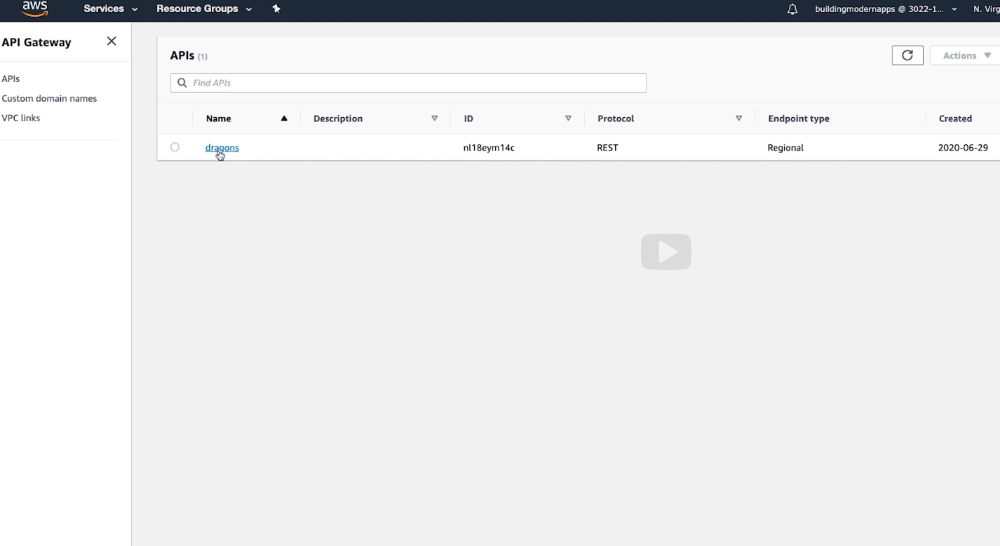
  
What I'm doing here is going into the Stages section for my API, selecting a stage,  
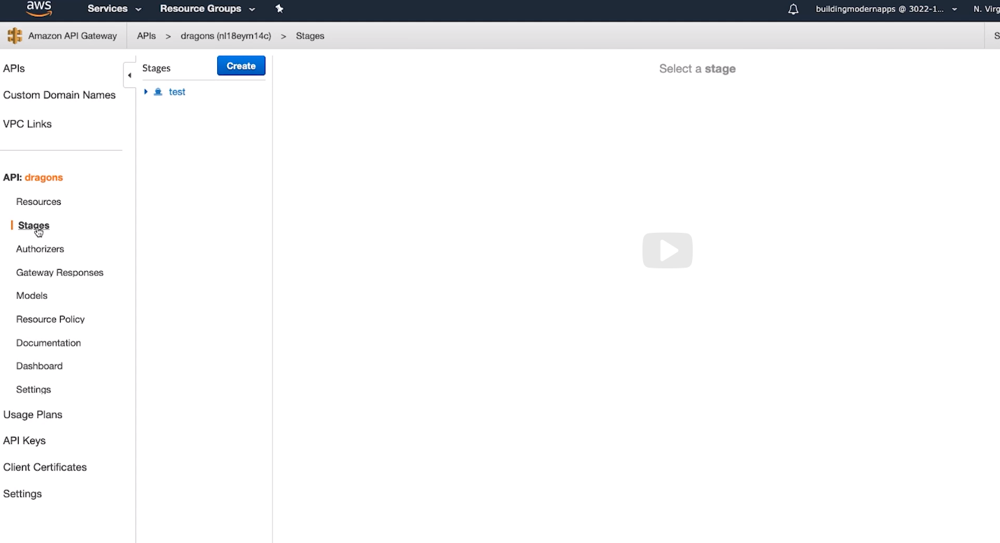
And
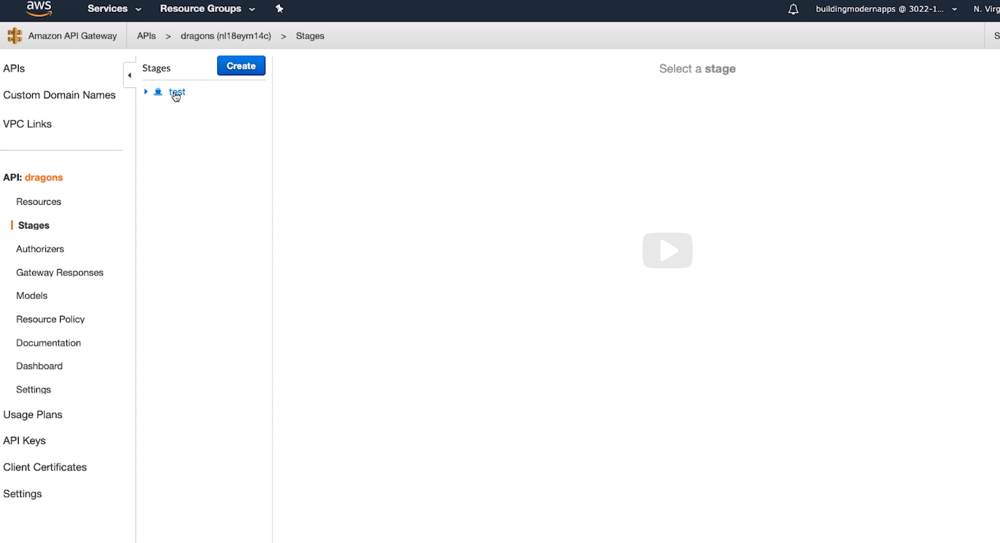
  
and then going to the Logs/Tracing tab of the stage editor.   
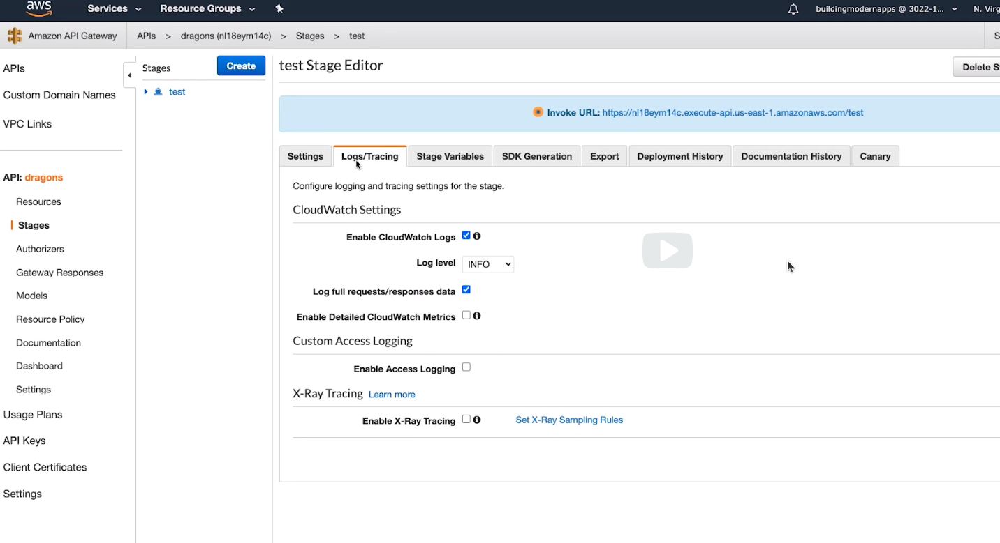
  
To enable the tracing, I simply look for X Ray Tracing,   
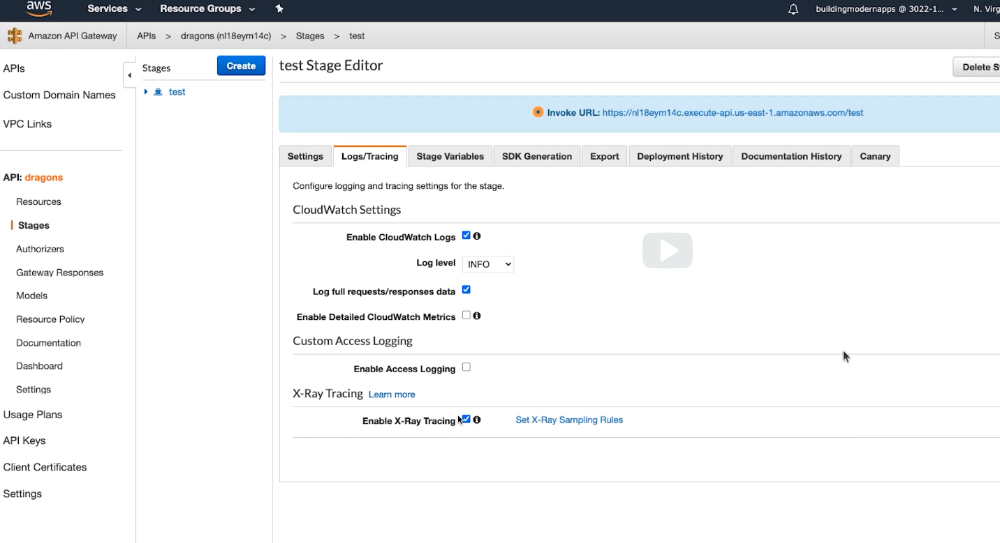
  
and then I enable it and save.
  
From here, if I want to adjust my sampling rules from the default, I simply have to choose set X-Ray sampling rules,  
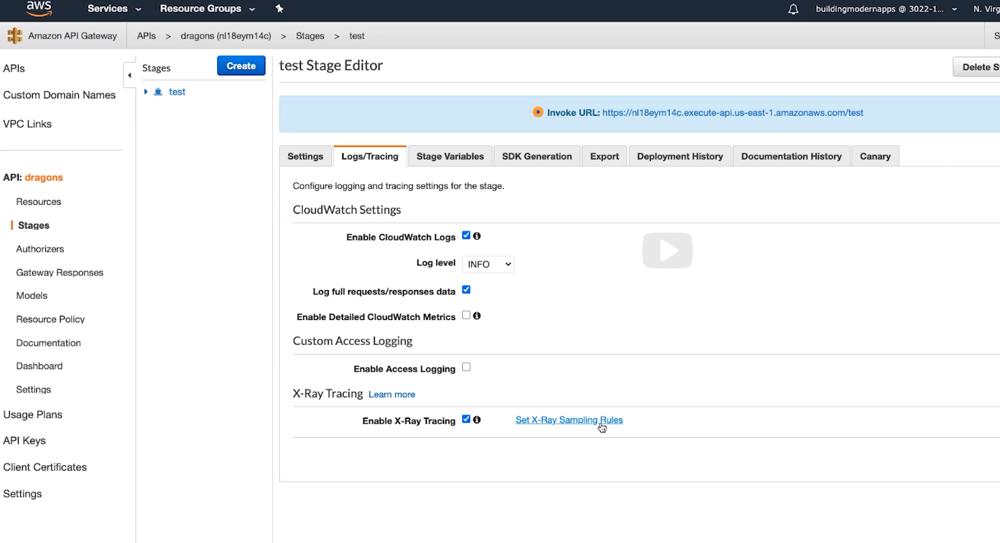
  
and I can go into the X-Ray console and configure the rules there.
  
Once I enable tracing on a stage, API Gateway will create a service linked role in the account if the role does not already exist. This role enables API Gateway and X-Ray to have the necessary communication in order to see the trace data. With AWS Lambda, if you've enabled X-Ray tracing, in a service that invokes your function,
Lambda trace data is sent to X-Ray automatically. The upstream service such as API Gateway, samples incoming requests, and adds a tracing header that tells Lambda
whether to send traces or not. Essentially, Lambda also supports both passive and active tracing. What I've just explained is the passive method.
  
But if you want to enable active tracing, this can be done through the functions configuration. For active tracing, what I'm doing is going into my function details,  
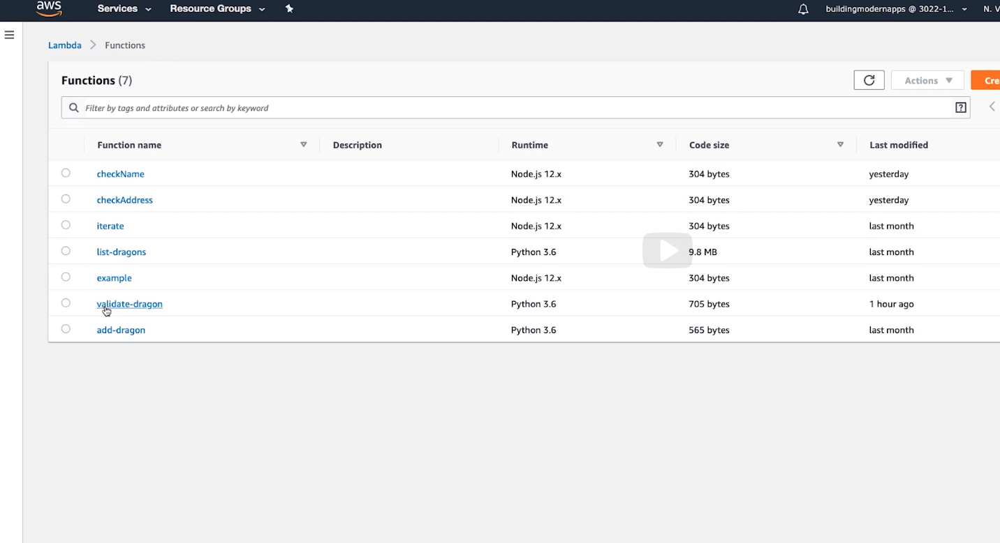
  
scrolling down to the AWS X-Ray pane,   
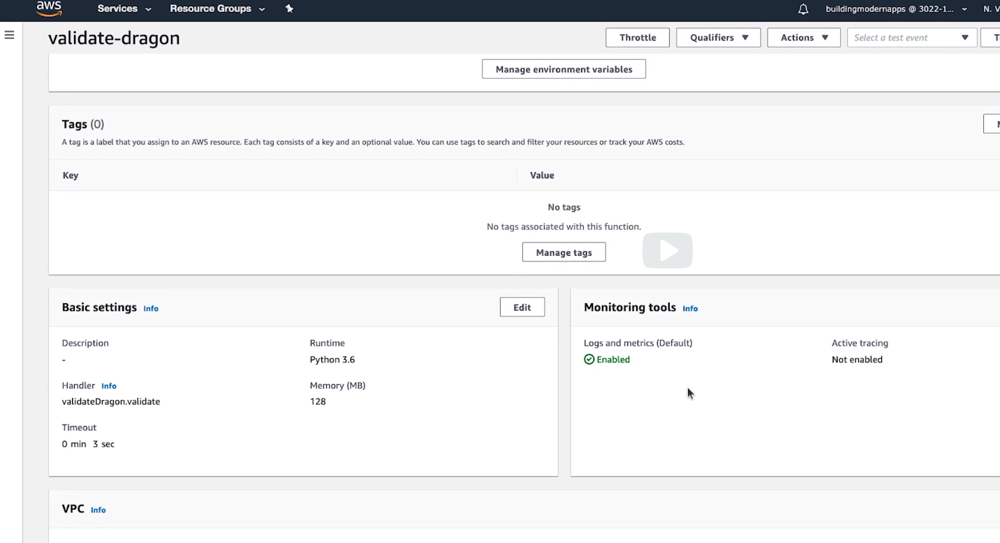
  
and just selecting the option for active tracing.  
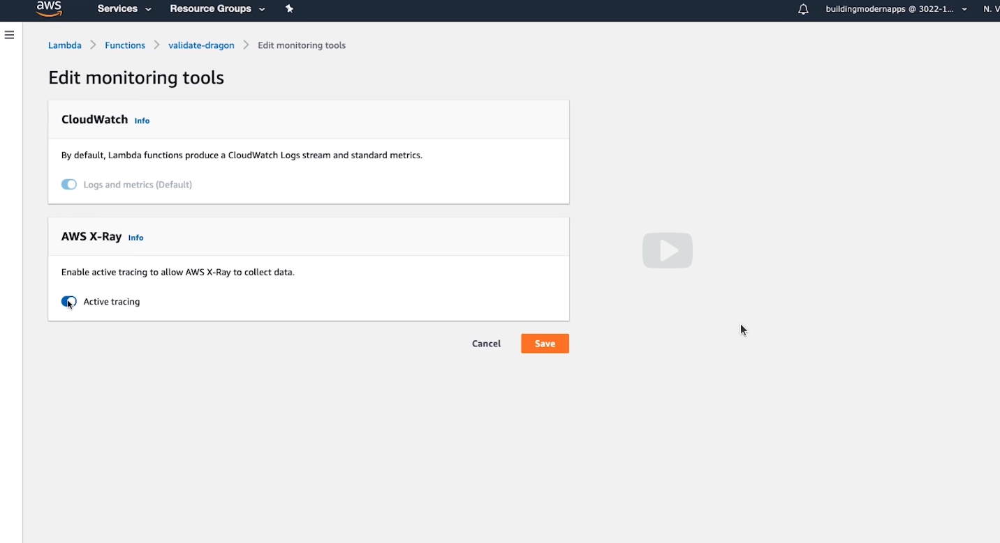
  
If by chance you have sampling being done by an upstream service, Lambda always records the trace data for those requests. The active tracing here will enable Lambda
to trace a subset of invocations that have not been sampled by the upstream service. Also, just like with the API Gateway, to send data to X-Ray, the function needs permission to upload trace data and telemetry in its execution role.   
The Lambda console will attempt to add these permissions to the execution role when you enable active tracing. There is of course, more that you can do to customize the data you're getting, but that's a deeper level and will require additional coding. Once that's all done, you can finally see the service map. I've already done some invocations in order to generate some data for us to see. So, let's take a look at what's here.  
  
I'll go over to X-Ray   
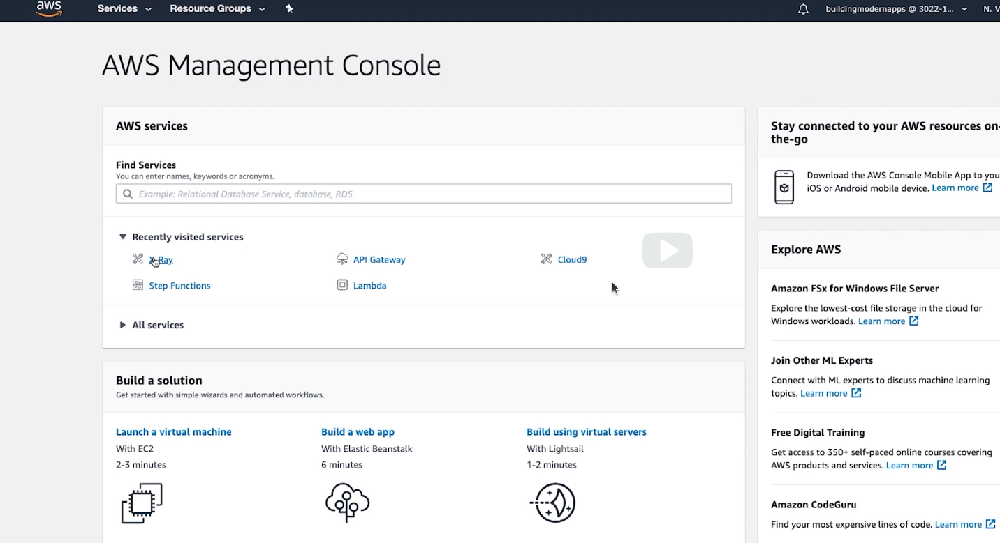
  
and bring up our service map.   
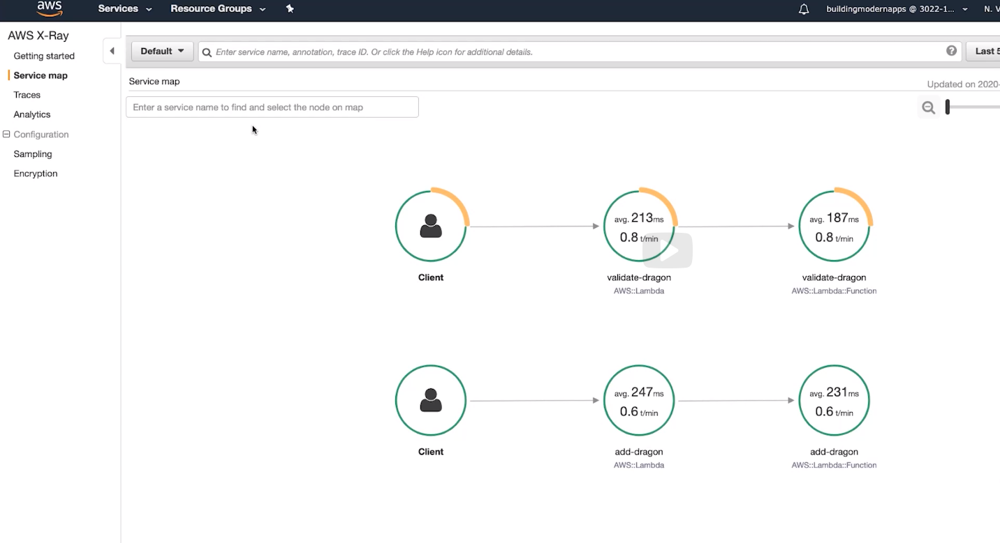
  
Here, you can see the tracing data that is being uploaded to X-Ray for you to be able to track what's going on in your application.  
  
What you can see now is the actions taken have enabled X-Ray to develop this service map, showing the path from the client to the application. It can also show the additional functions that are processing the request in Lambda, giving insight into the components of our application.   
  
Selecting one of the components brings up the service details  
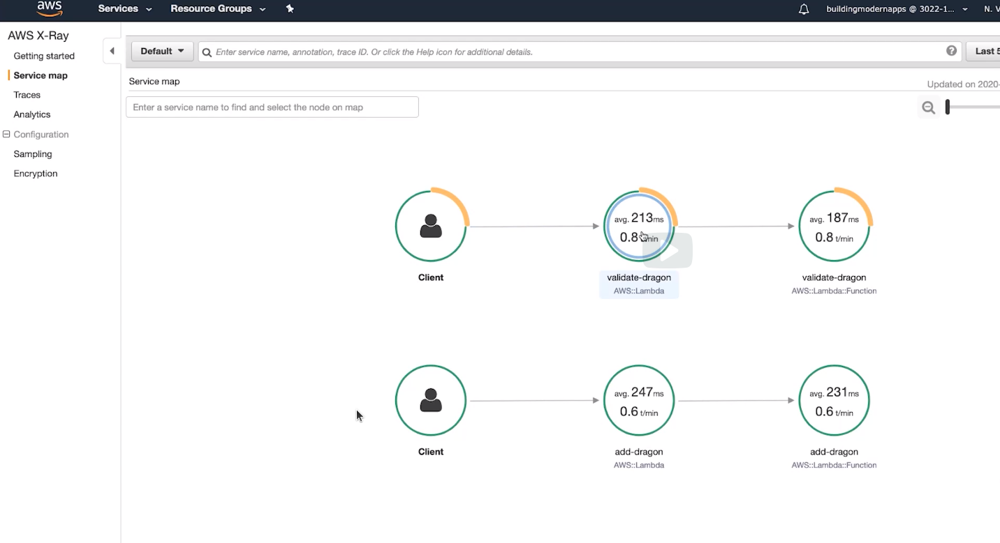
  
which will include the name, the service type, the response distribution, and more.   
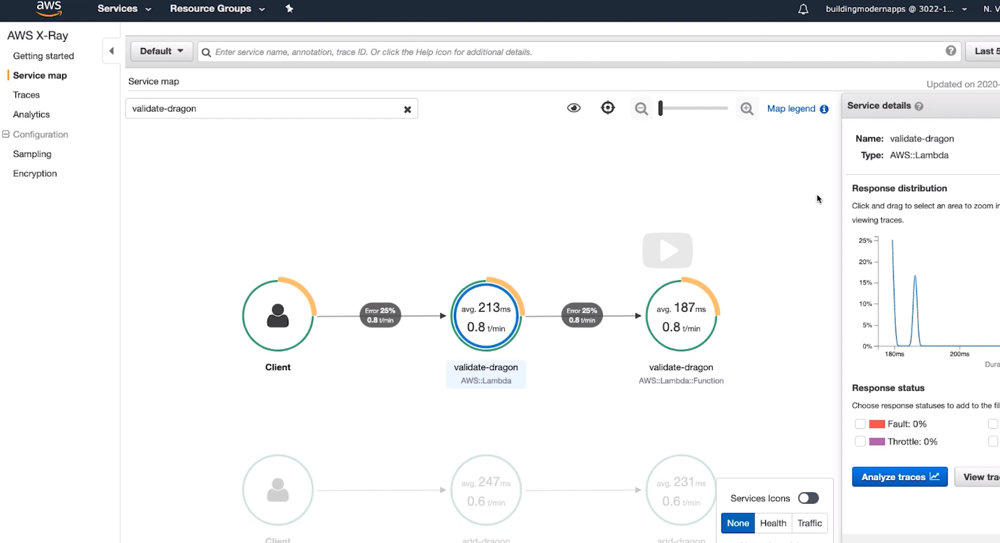
  
If I go to the left hand column and select traces,   
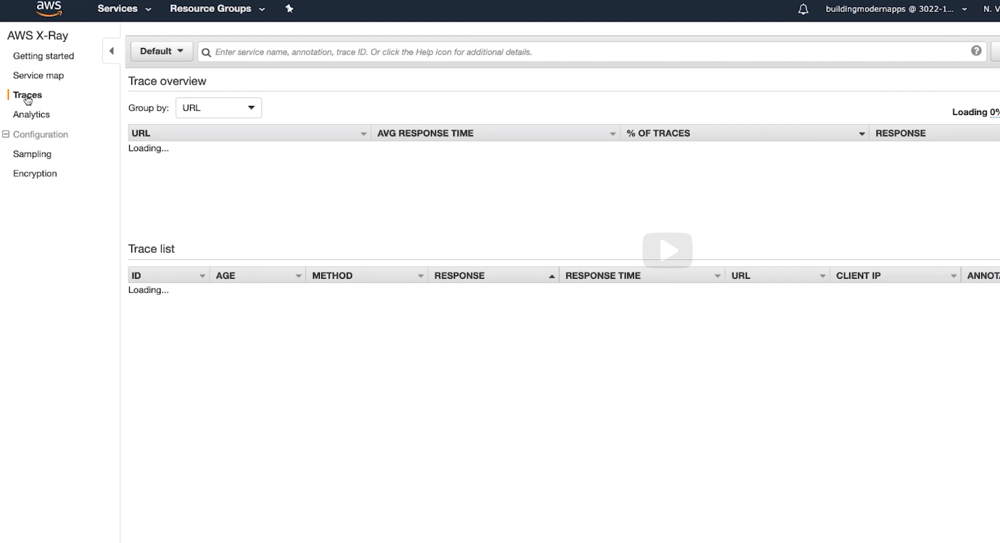
  
I can organize data based on URL, status code, method, and a lot of other options.  
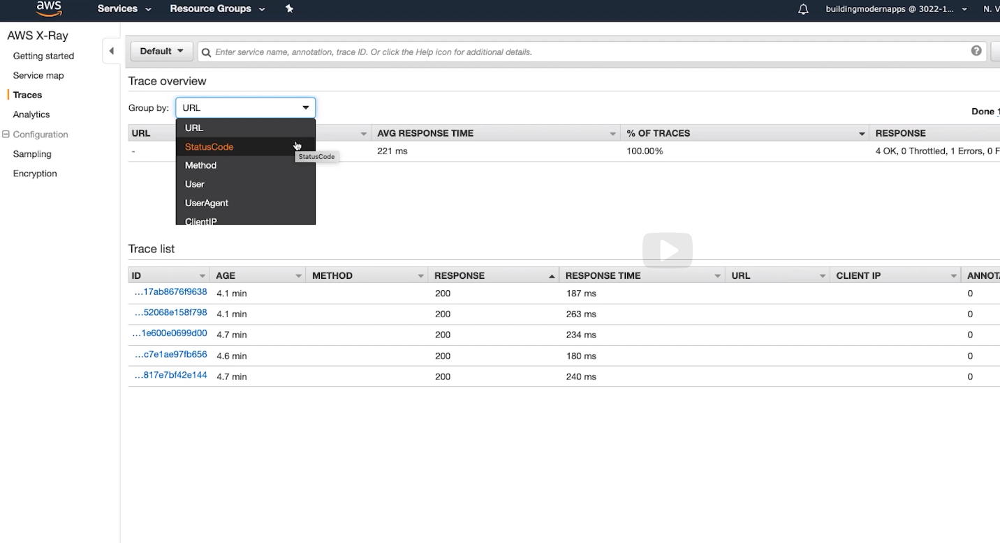
  
Lower on the page, there's the trace list, which is a historic view, giving us the ability to look at a service map for specific traces that occurred in the past.  
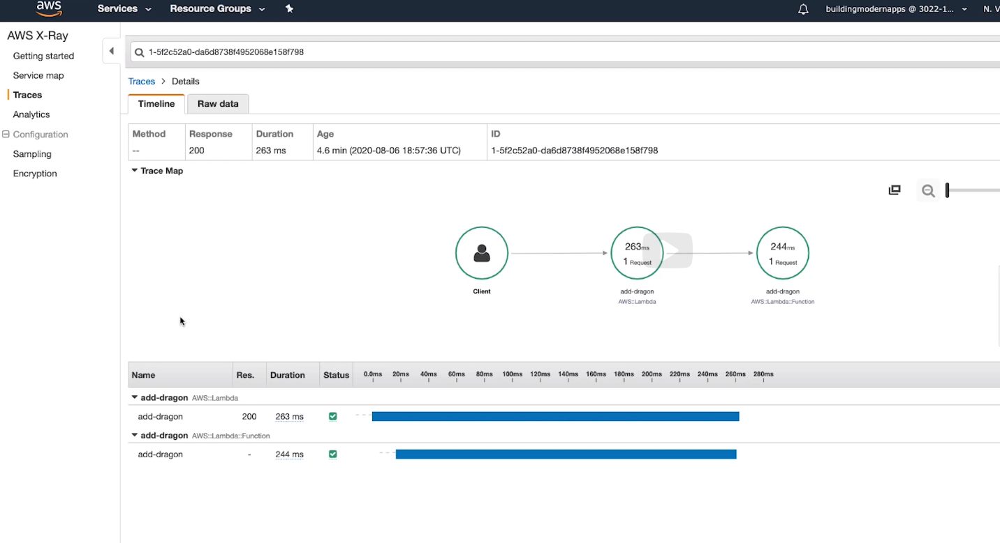
  
I hope that helps to show how easy it is to start tracing with AWS X-Ray. We will see more about X-Ray in the next, but that should get you started.

<pre>


    
</pre>
### Using X-Ray: Python

Here I'm going to show you how to use the X-Ray SDK in your Python project. The X-Ray SDK for Python is a library that provides functionality for creating and sending trace data to the X-Ray daemon. The X-Ray daemon is a process that runs on a host machine that gathers raw trace segments and then periodically uploads that data to the X-Ray API. The daemon works with the AWS X-Ray SDK, and must be running so the data sent by the SDKs can reach the X-Ray service. So your code doesn't directly submit traces to the X-Ray API, instead, it records them to the X-Ray daemon. With Lambda functions, this X-Ray daemon is sort of a black box because it is already installed and running in the Lambda execution environment without you needing to do anything.  
  
All you need to do is use the X-Ray SDK, enable tracing for your Lambda function through its configuration, either during creation or through an update, and it will all work and you'll be able to view your service map and see your traces.   
The trace data being sent to X-Ray includes information about 
    * incoming HTTP requests served by the application 
    * and calls that the application makes to downstream services using the AWS SDK, 
    * HTTP clients, 
    * or a SQL database connector.  
  
For Python functions running inside of Lambda, you actually don't need to include the X-Ray SDK in your project. It is optional, similar to boto3. If you don't use it in your function, your service map will still include a node for the Lambda service and one for each Lambda function. However, you won't be able to add any custom information to a segment if you choose not to include the X-Ray SDK in your Lambda code. If you do choose to include the X-Ray SDK, you can then use it to add subsegments to the segments recorded by Lambda.   
  
Sub-segments allow you to provide a more granular timing information and details around the calls that your application is made.  
And you can also create arbitrary subsegments around specific lines of code or specific calls. This allows you deeper visibility into your code that the X-Ray SDK might not record for you by default, which can be very helpful when your applications are needing of debugging or troubleshooting.  
When you use X-Ray in your application, the X-Ray SDK records information about incoming and outgoing requests, the AWS resources used and the application itself.   
  
Beyond creating subsegments, you can add other custom information to the segment document as annotations and metadata. Annotations and metadata are aggregated at the trace level, and can be added to any segment or subsegment. Annotations allow you to associate key value pairs with a trace that can then be filtered in the X-Ray console. This is useful for searching and grouping traces.   
  
Metadata information cannot be searched upon, but it can be used to store data that can provide further information, but isn't searchable like annotations are. Metadata can be key value pairs, objects or lists. That is handy because you can store more complex information in metadata than you would in an annotation.   
  
So now what we're going to do is go into Cloud9 and we are going to implement tracing with X-Ray for our list-dragons Lambda function. And then you would do it the same way for add and validate dragon. I'm already up and running inside of my Cloud9 instance.  
  
So what I'm going to do now is add the X-Ray SDK to the listDragons function that I have right here. So let's go ahead and open up listDragons.py.  
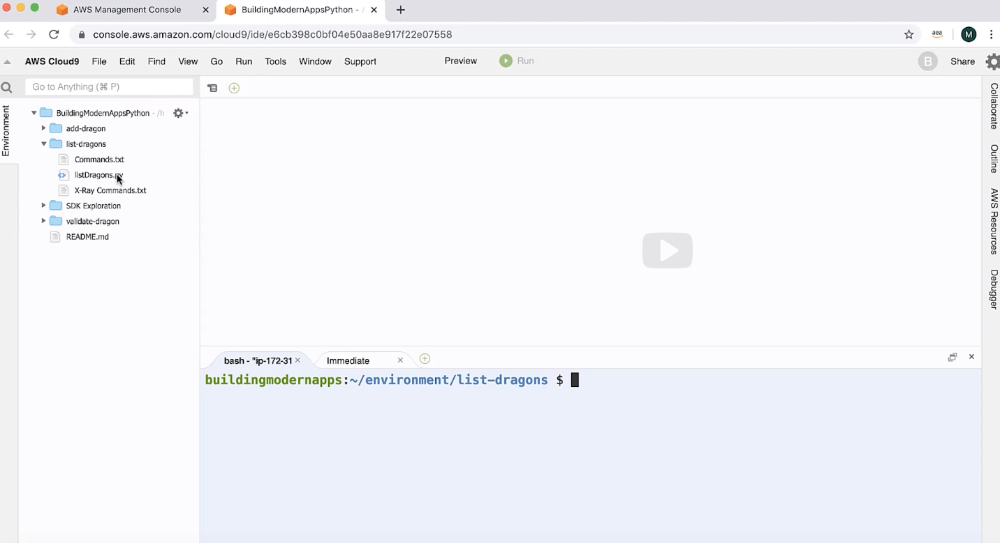
  
So what I want to do is add the SDK for X-Ray and use it in this code snippet.  
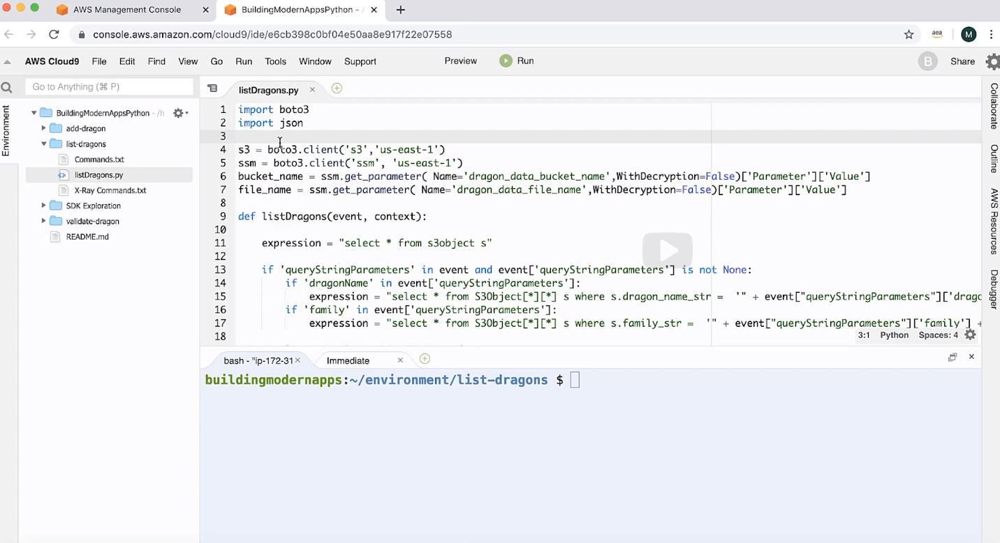
  
Since Lambda will record segments for you, but not any downstream calls that your code makes to other AWS resources, I want to implement that downstream tracing. So we can trace how long our calls to S3 are taking. Specifically, we scroll down this call this select_object_content, I want to trace that.  
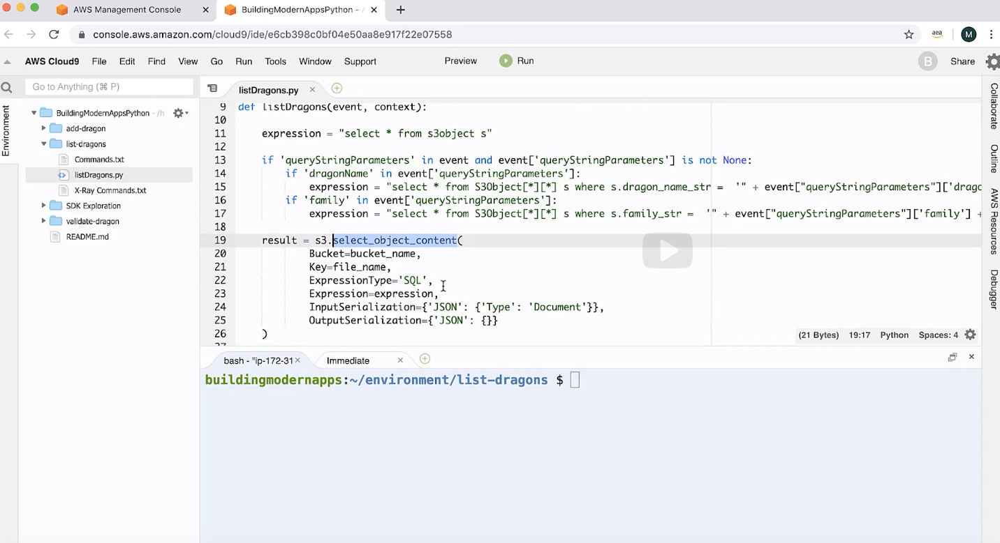
  
You could implement this in your project to trace how long it would take to make calls to DynamoDB or working with SQS queues or to any other resource that AWS calls using the AWS SDK. Now, before we can actually use the X-Ray SDK, first things first, we need to download the X-Ray SDK.  
  
So now let's open up this X-Ray Commands.txt.  
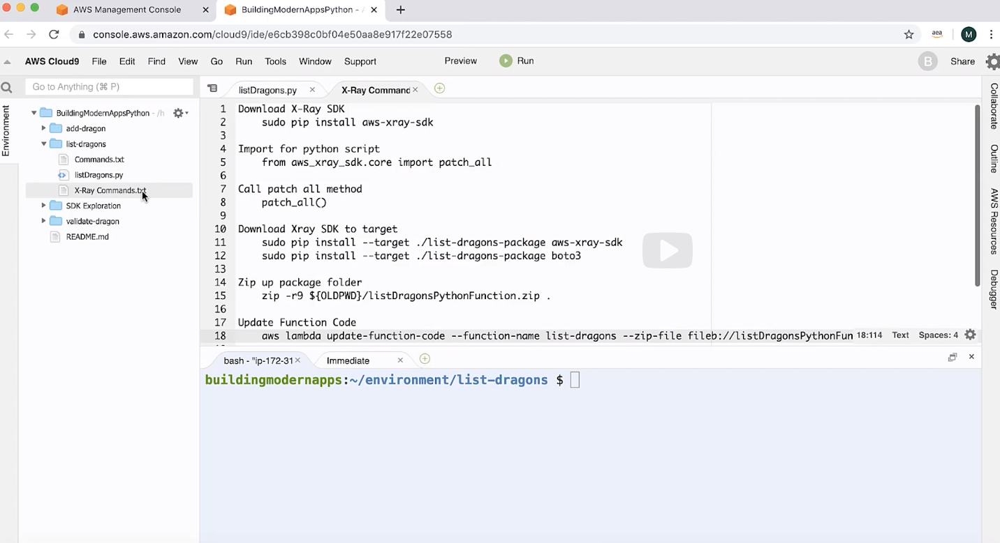
  
And this has all the commands that we needed to run step by step, as well as some things that we're going to include in our list Dragons' Python script, to work with the X-Ray SDK. So let's go ahead first and download the X-Ray SDK. That's done. Good to go.  
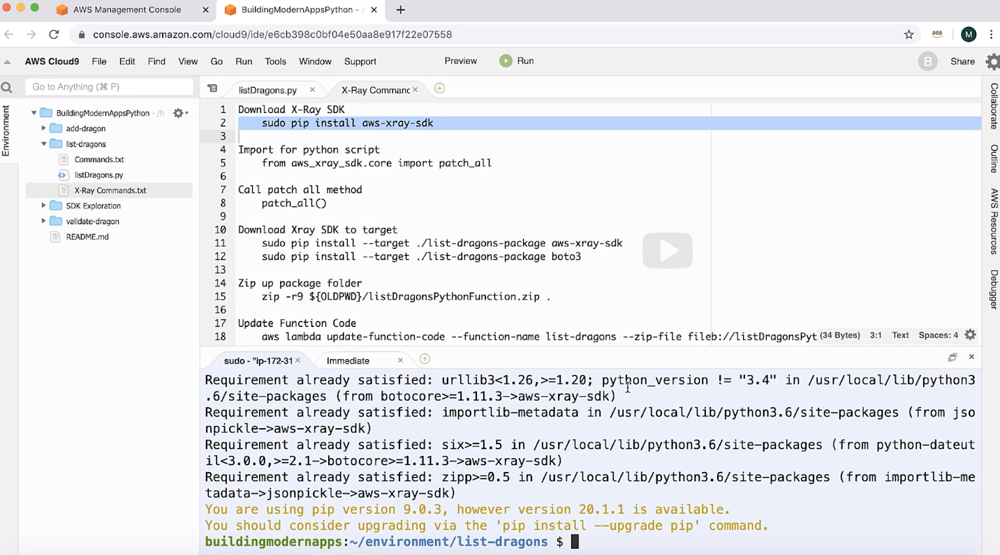
  
Now, what we want to do, is copy this next line here.  
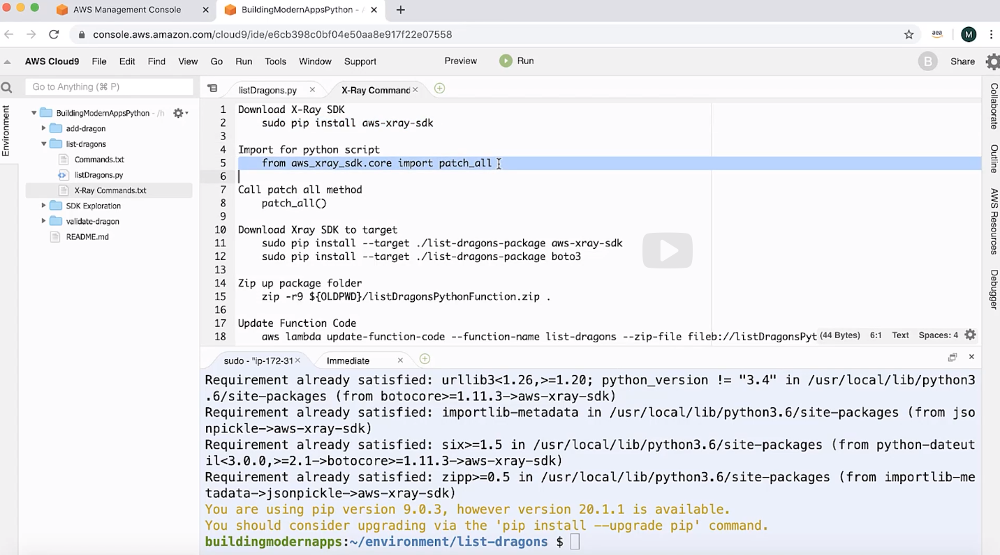
  
Go back to the list-dragons Python function, and then paste that here.  
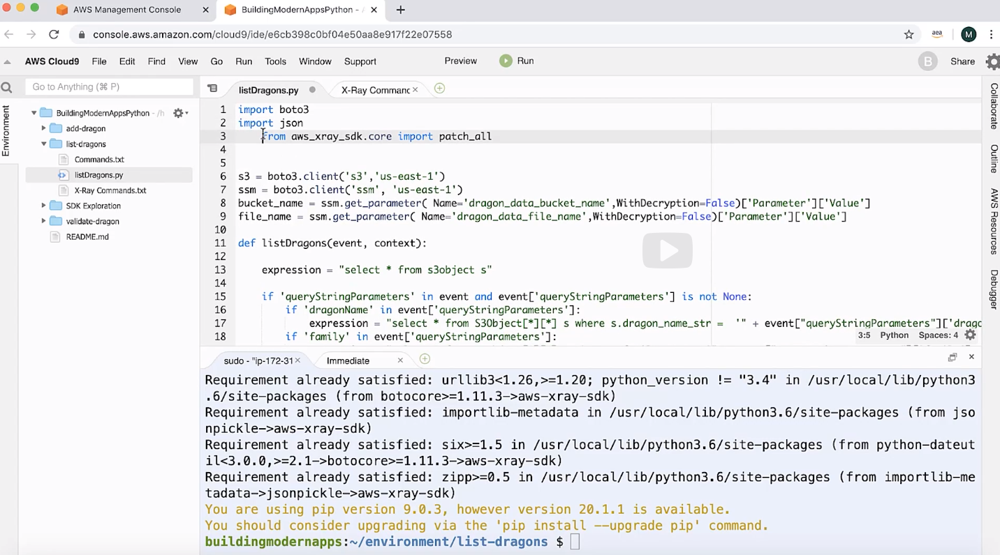
  
From aws_xray_sdk.core import patch_all. Then I want to call this patch_all methods. I'm just going to copy it and paste it over, first thing in our code, and then save that.   
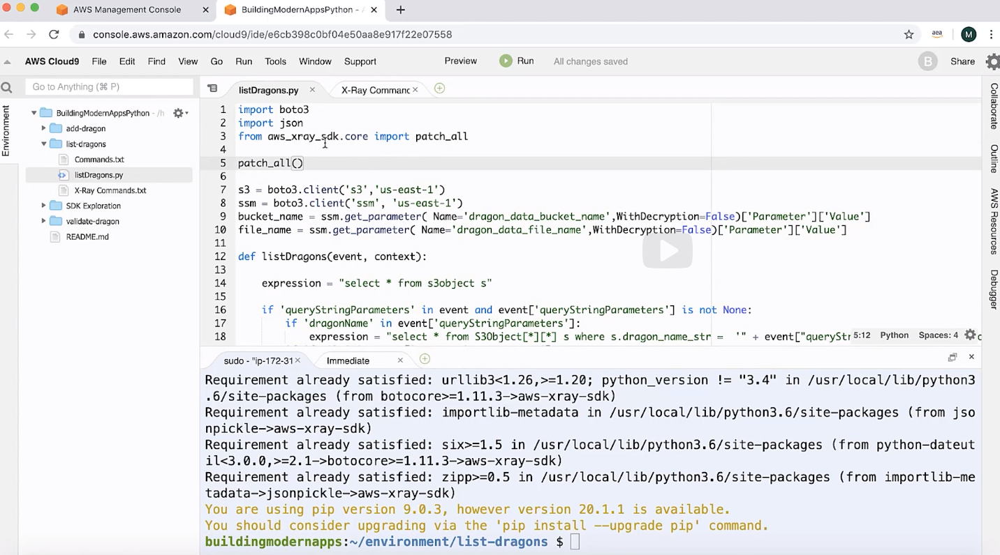
  
So we're importing the aws_xray_sdk, specifically the one method that we want to use, which is this patch_all method. And this patch_all method is going to allow us to record downstream calls to other AWS resources. So without this patch_all, this call select_object_content   
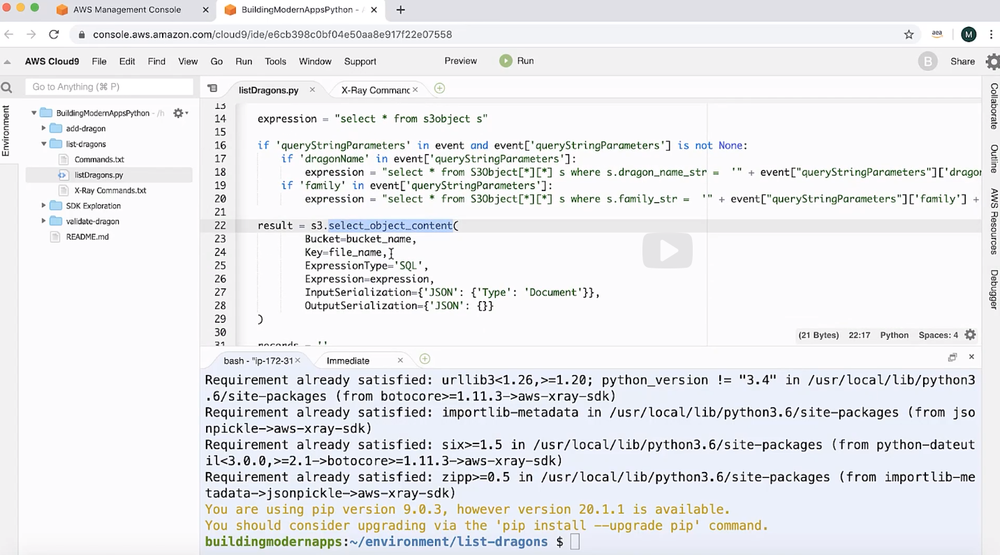
  
would not be included as a separate object in the service map for the tracing. So we want to go ahead and call patch_all here.  
  
Then what we want to do now is download the AWS X-Ray SDK as a dependency into a deployment package. So as a reminder, Lambda functions for Python, for deployment packages are zip files. The zip file for your deployment package, must contain the code, so the listDragons.py file and all of its dependencies. In this particular use case, the dependencies are the AWS X-Ray SDK and boto3. I want to include both of those things in my deployment package. So let's go ahead and run the first command here which is going to download the X-Ray SDK into this list-dragons-package folder.  
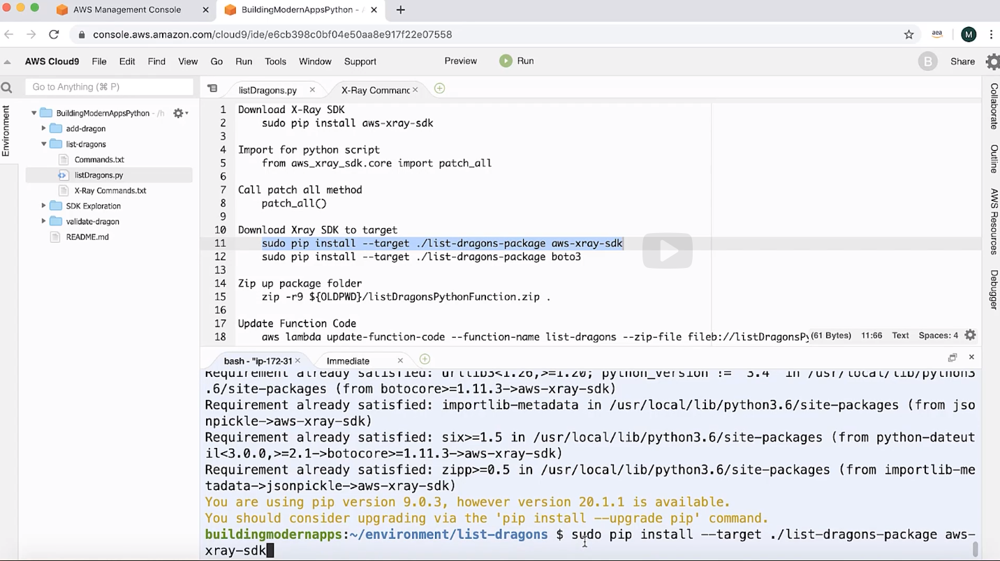
  
So let's go ahead and take a look at that.   
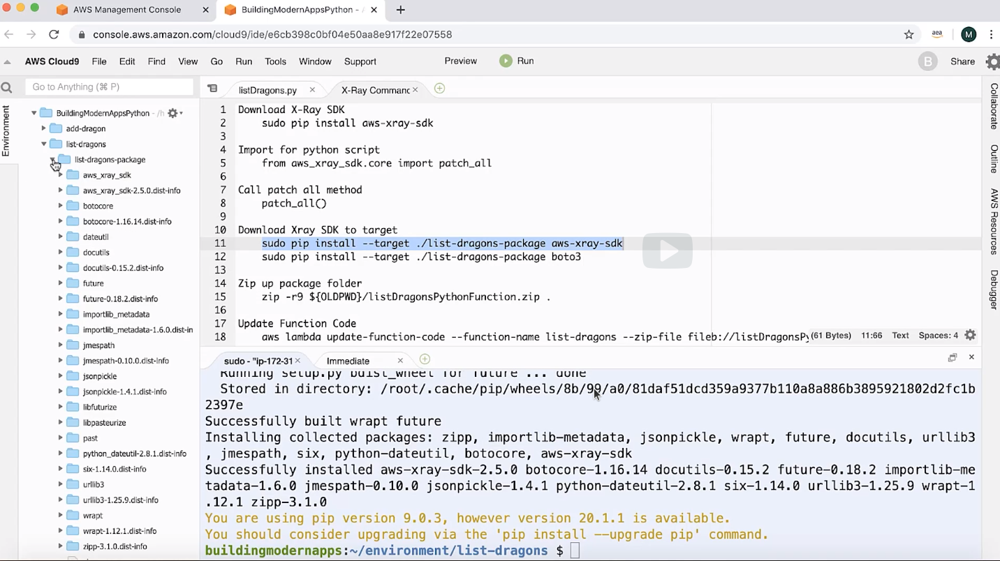
  
See, we're good to go there. Alright, so that looks like that downloaded. Let's go ahead and do the next dependency which is boto3.   
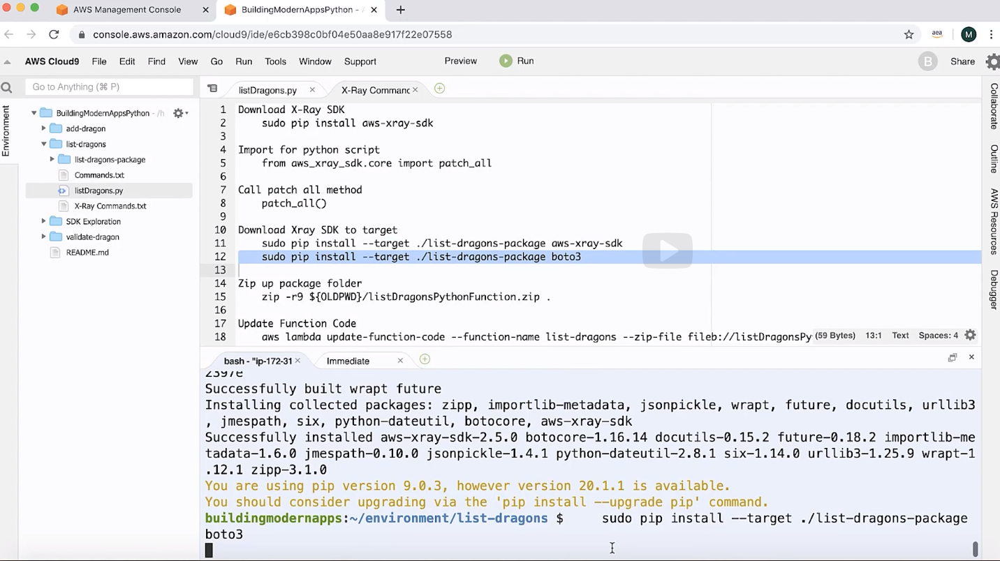
  
If we open this up,   
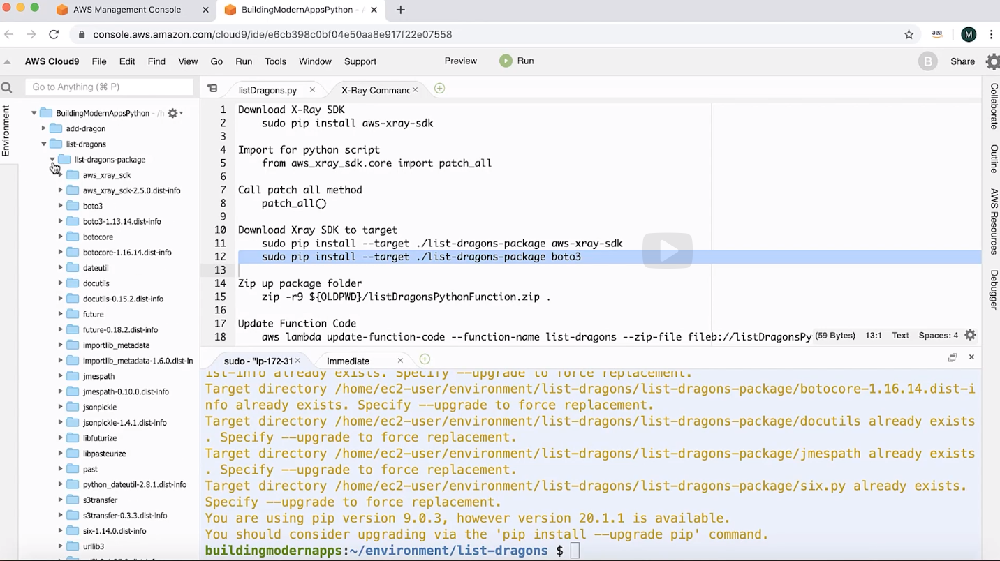
  
we can now see boto3 is also included in that package. So now let's change directories. To go inside of that list-dragons-package directory.   
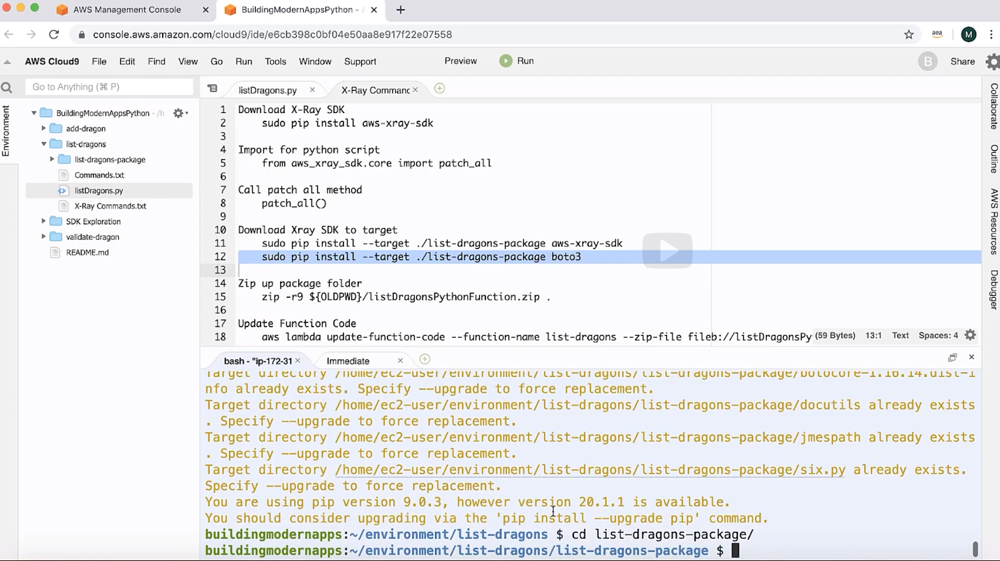
  
And let's zip it up.   
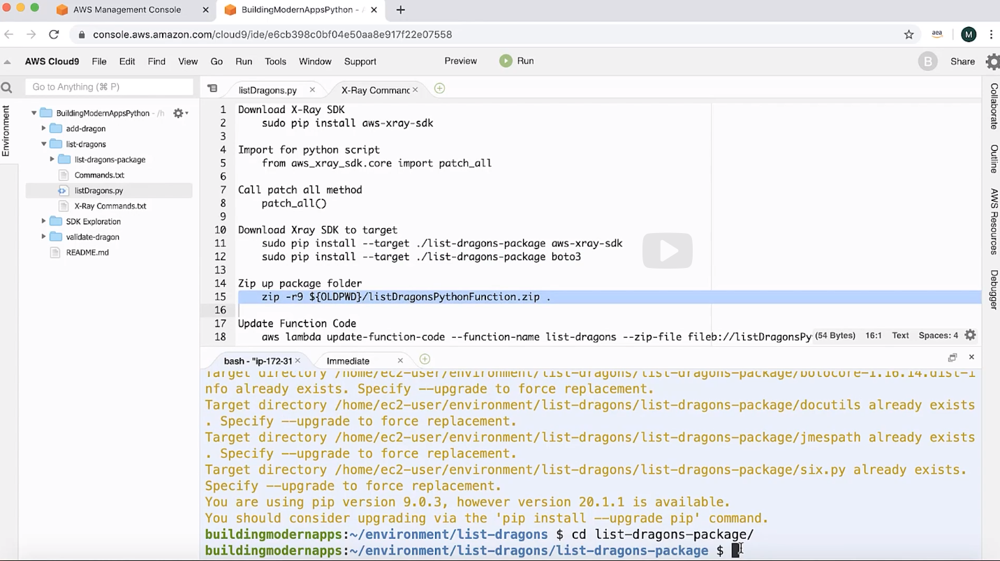
  
Okay, great. And I'm actually missing a command here so I'm going to steal it from this one.  
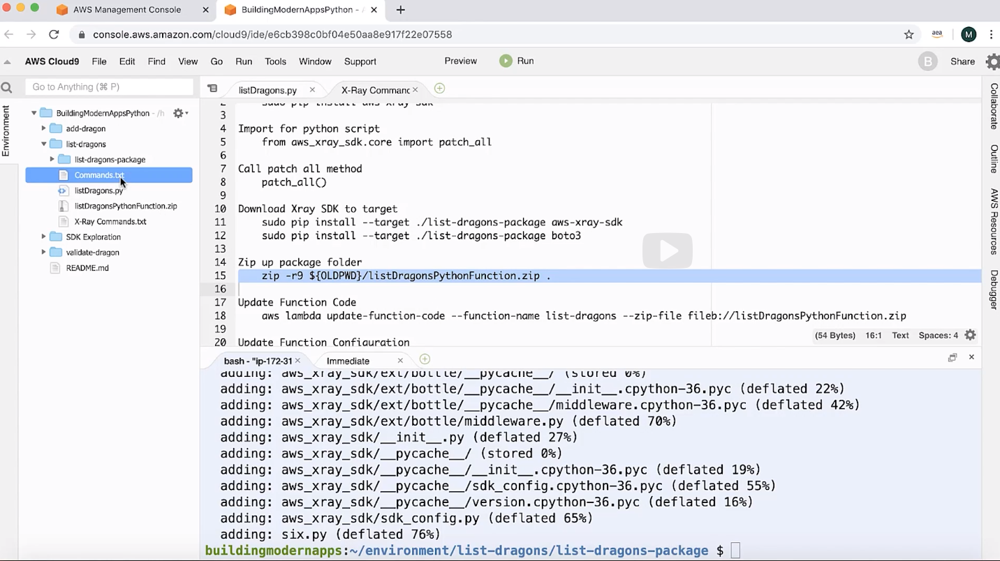
  
So I'm Just copy this over.   
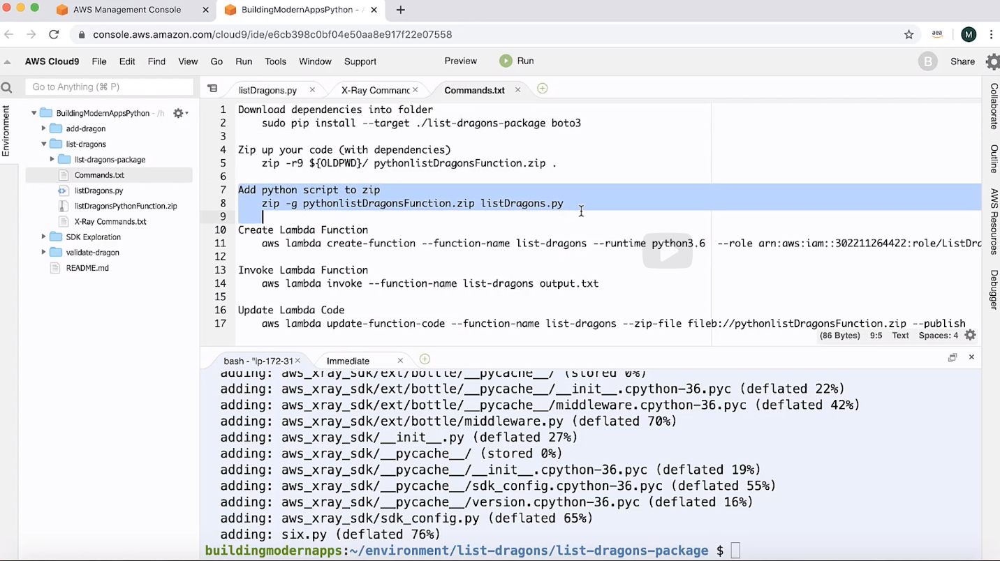
And  
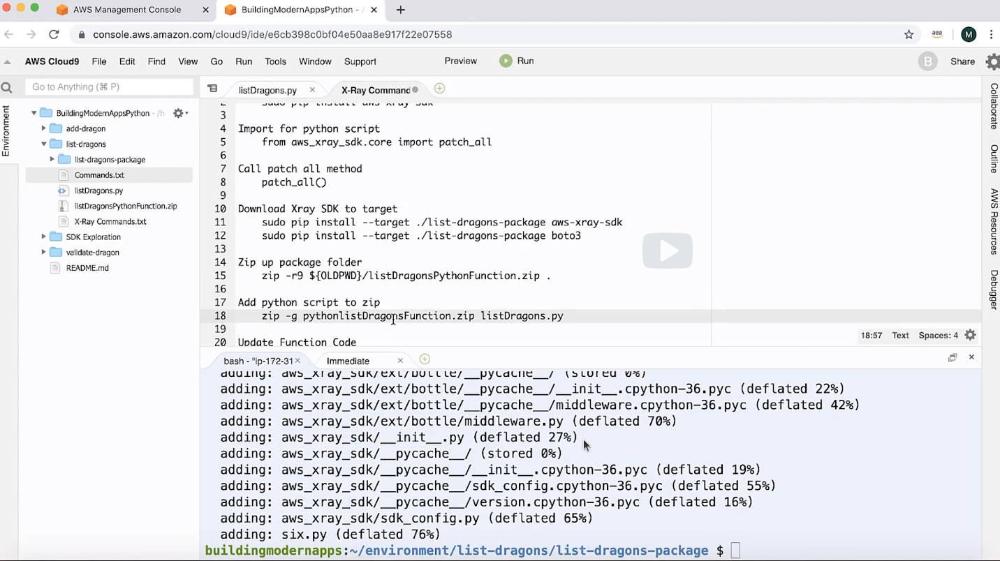
  
The next command is we want to add this listDragons Python file to the zip that we just made. So let's go ahead and run that.   
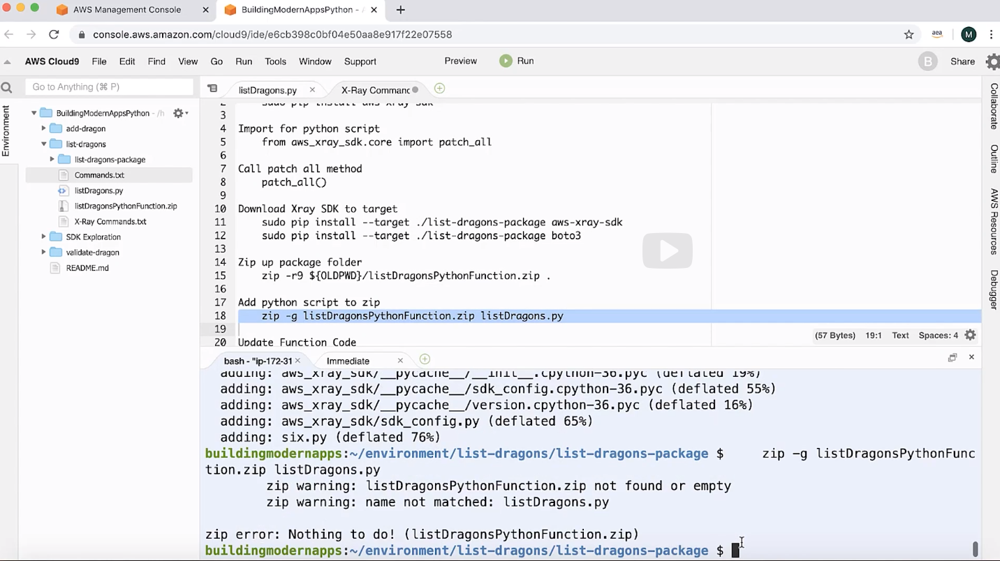
  
Oh, I have to go ahead and change directories, and then run it again.   
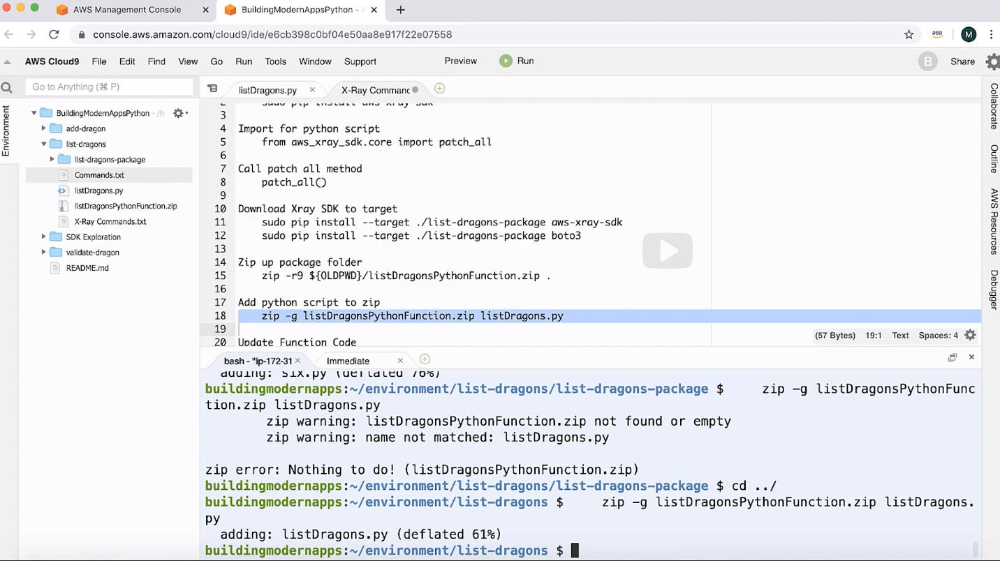
  
There we go. That worked great. So now, the listDragonsFunction is inside of that zip. And now the listDragonFunction already exists. So we are going to create a new Lambda function, instead, we're going to utilize the update function code API call. So we're going to call aws Lambda update-function-code, function name list-dragons, zip-file, listDragonsPythonFunction.zip. So go ahead and copy that. Paste it.  
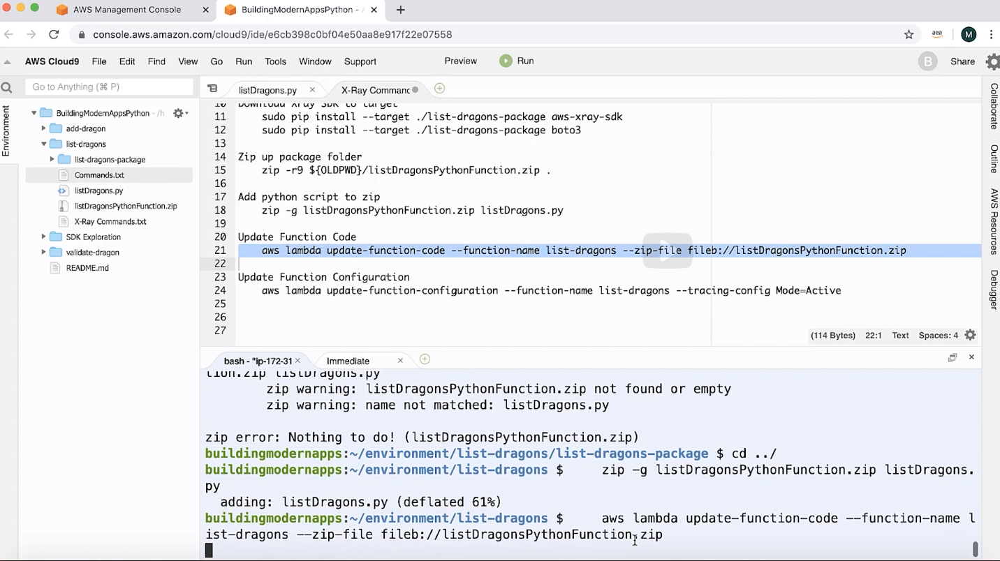
  
And you can now see if we scroll up here, we have a response that came back that indicates that this was successful.  
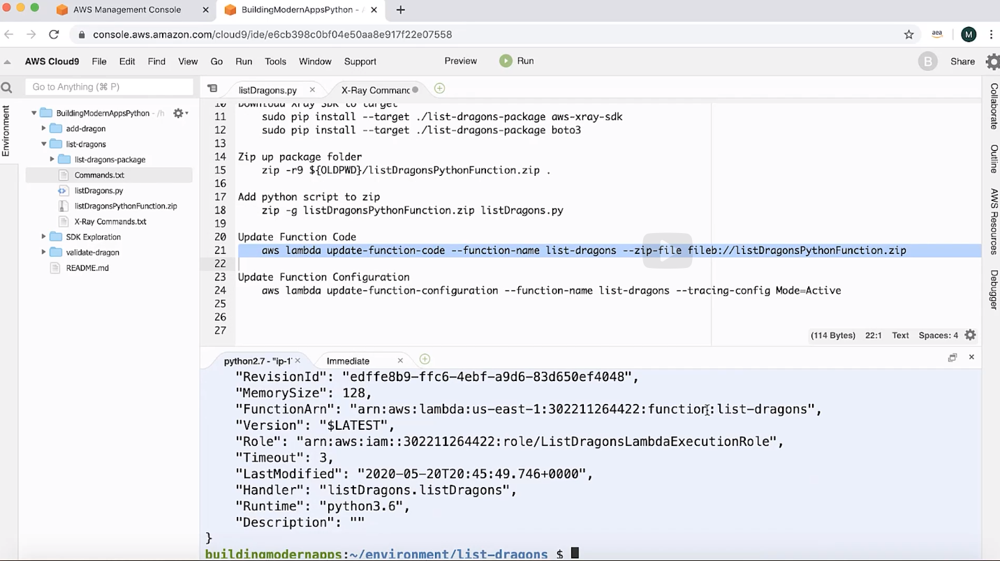
  
And if I also add the published flag here,  
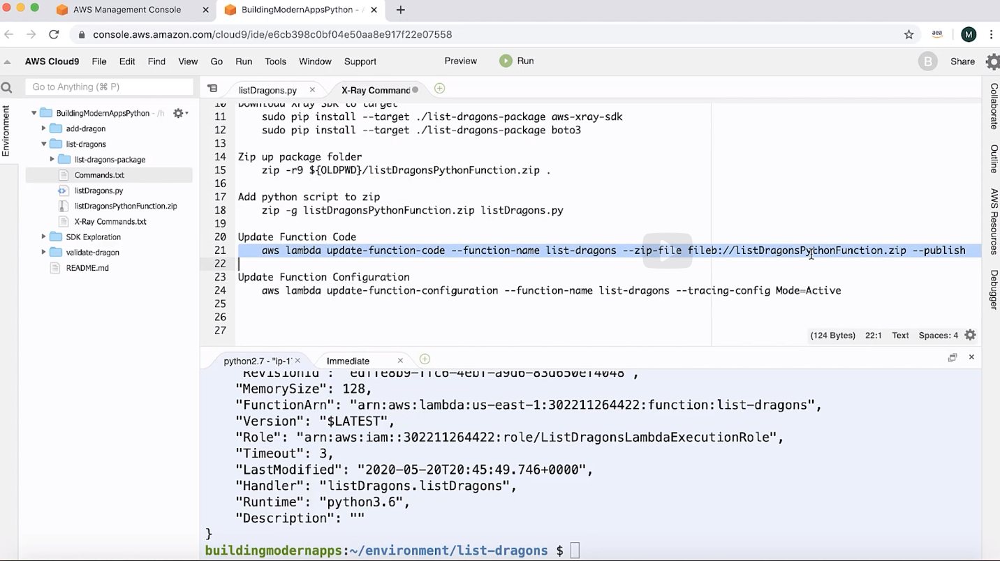
  
and then do it again, notice how this version says latest,  
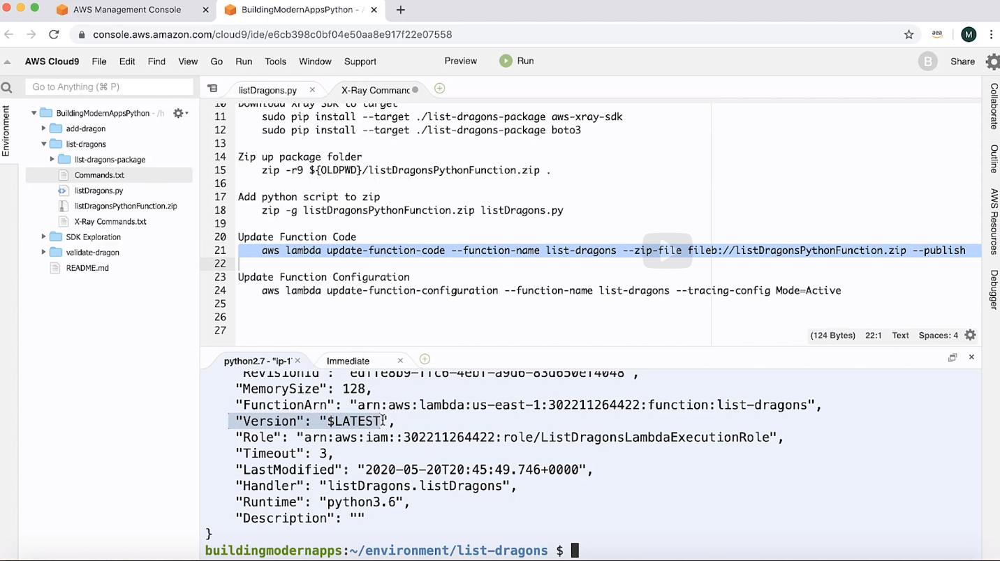
  
I'm going to run it one more time.  
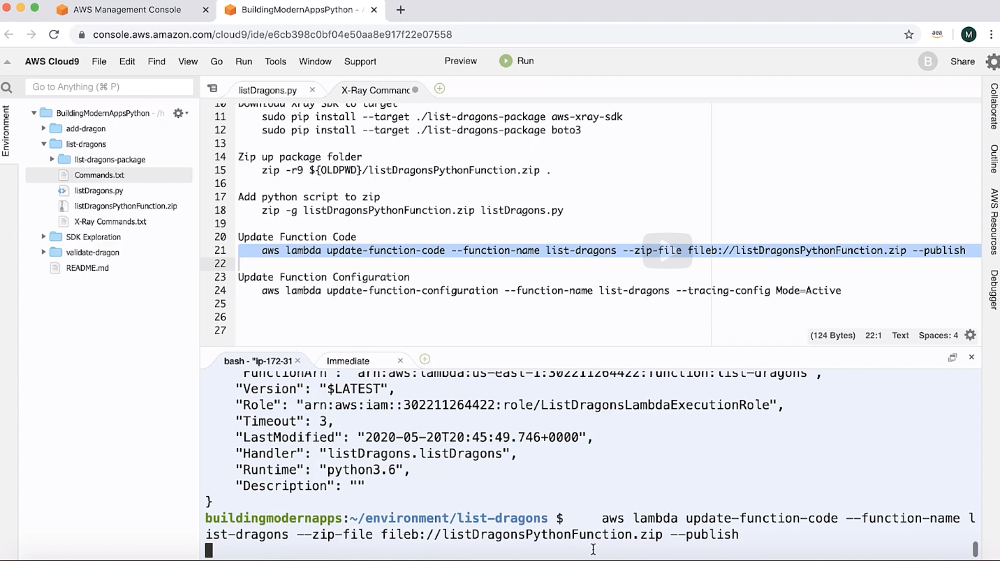
  
Now you can see version four.  
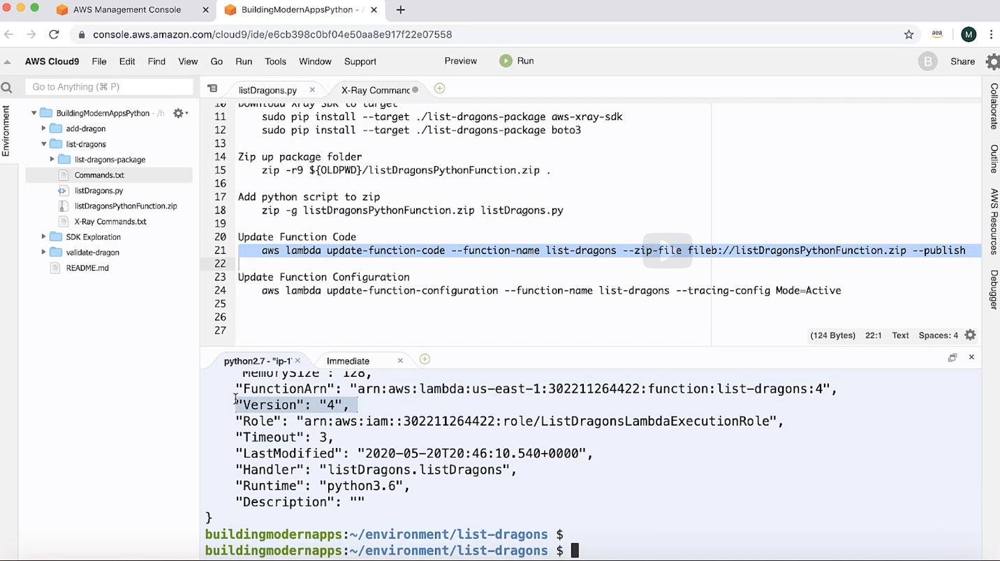
  
So I actually created a new version of this Lambda function by adding that publish flag.  
And now let's update the function configuration. And this is going to turn on tracing for this Lambda function. So aws Lambda update-function-configuration, function-name, lists-dragons, tracing-config mode=active. If we scroll up here, you can see that the tracing-config was set to mode PassThrough. That means that Lambda was not automatically sending trace data to X-Ray. By changing that to mode equals active, it's going to start sending information. 
So now if we scroll up, we can see tracing mode is now active, which is awesome. That's exactly what we want. So now what I want to do is actually invoke this function using Curl, using the command line, I wannna be able to see it go all the way through API Gateway to Lambda talking to S3 and back. So in order to do that,
we need to grab the endpoint for this API. So I'm going to go back into the AWS Management Console.  
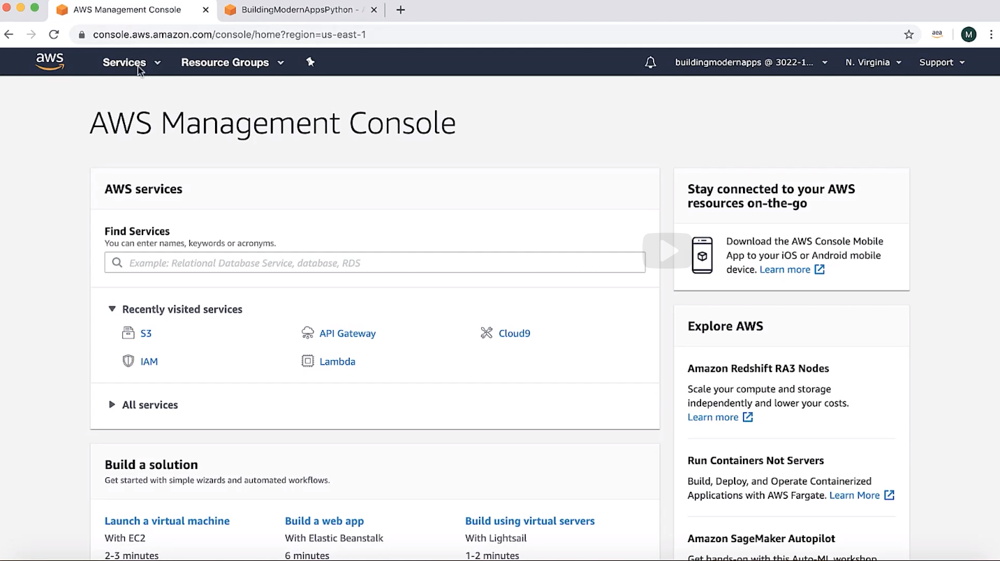
  
I'm going to navigate to API Gateway.   
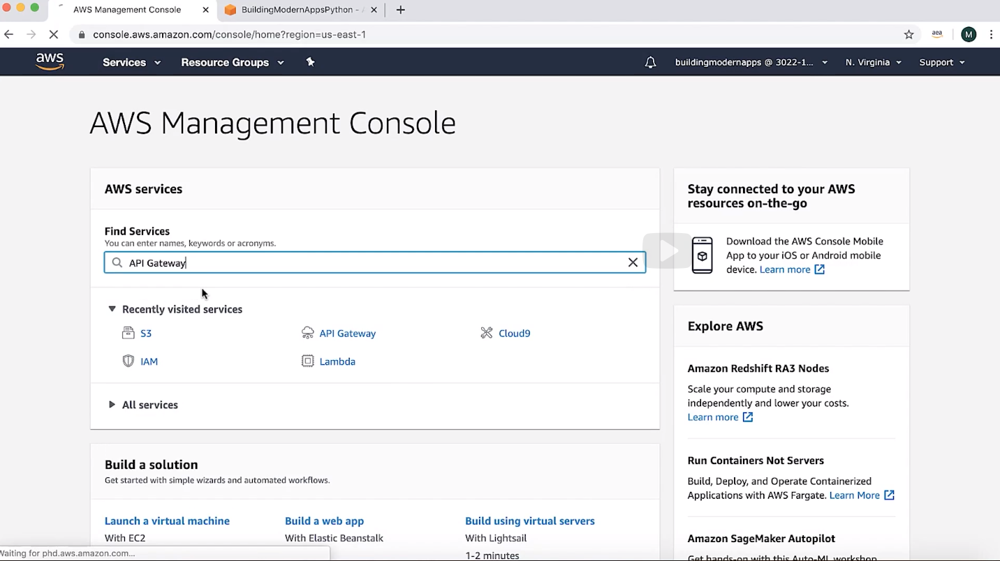
  
Take our dragons API.   
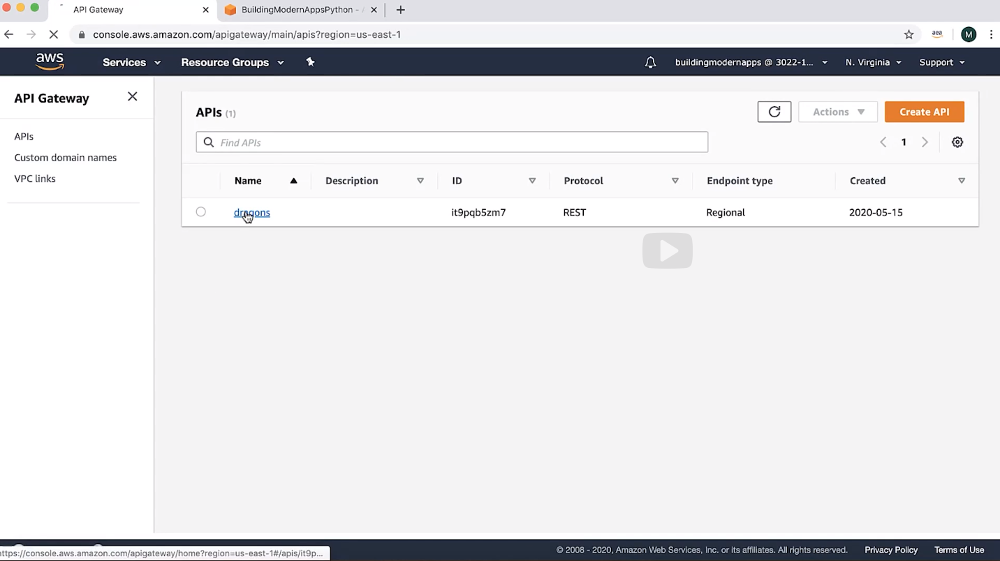
  
I'm going to go ahead and deploy this API.   
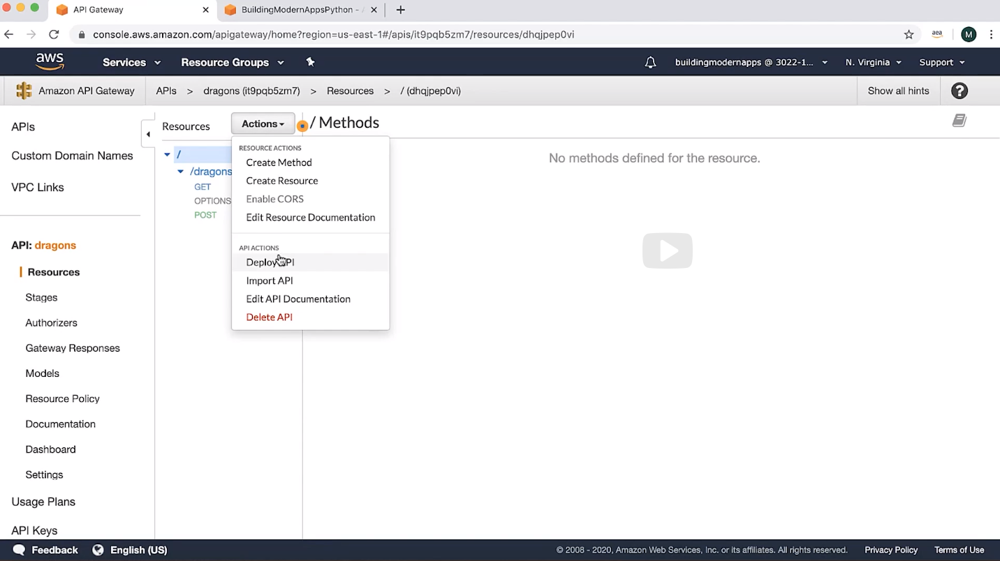
And  
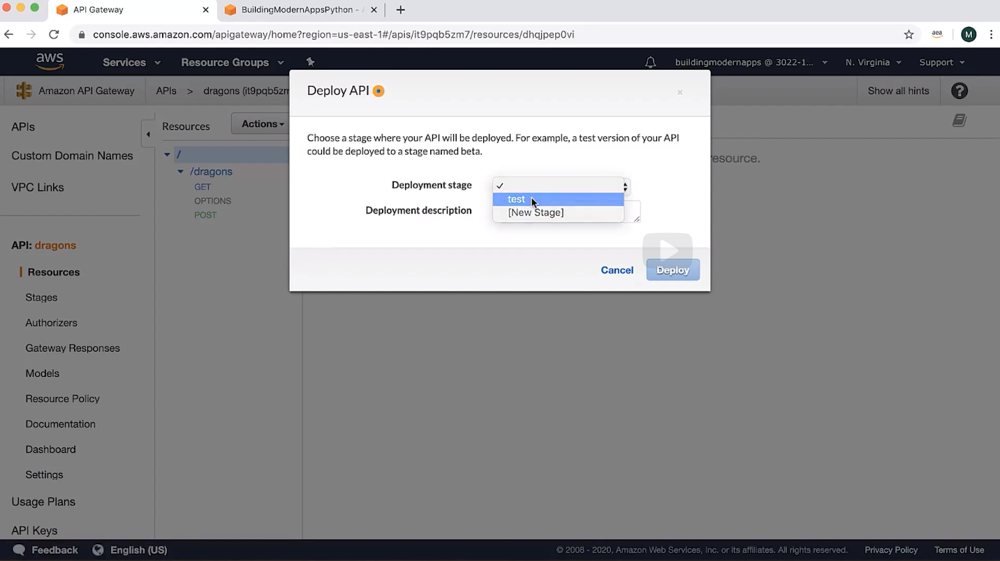
And  
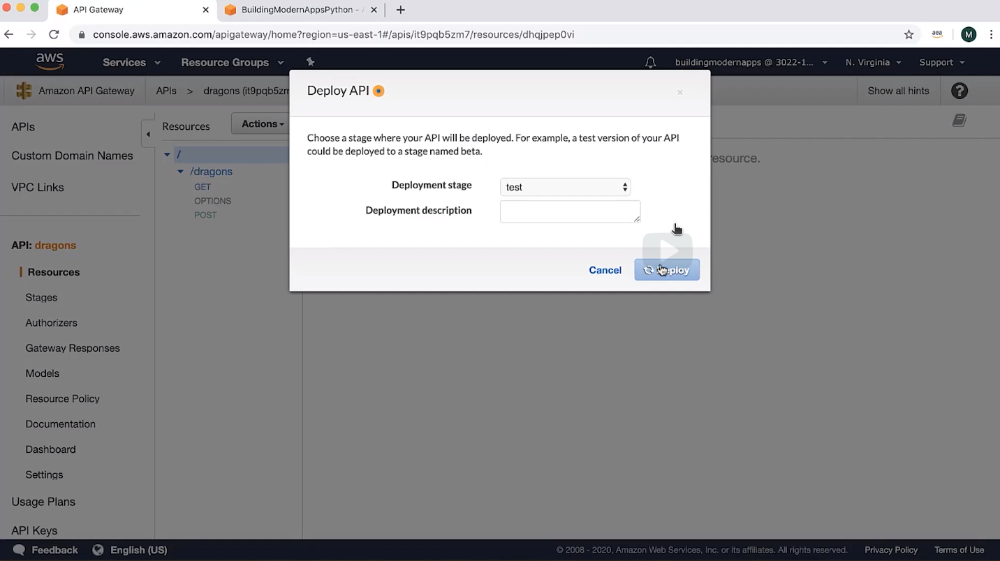
  
And I'm deploying it because we made changes before that we didn't get to deploy yet.   
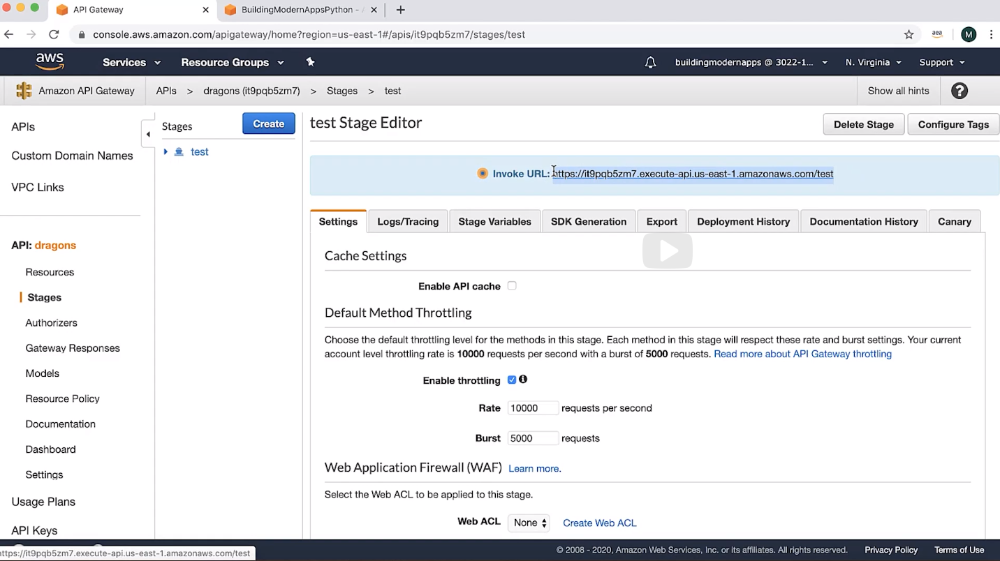
  
So I'm just deploying it to make sure that any changes that we might have made, make it to that stage, because something with API Gateway, is if you want to use API Gateway with the latest changes that you've made, you have to deploy it between every single step. I'm also going to come in here and just go ahead and turn on X-Ray Tracing. Click Save.  
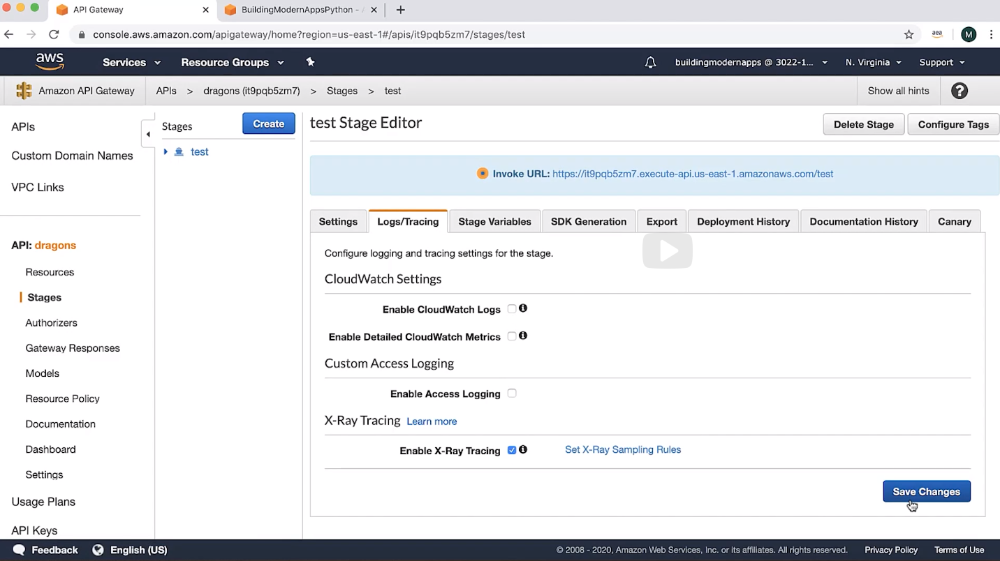
  
And while that's saving, let's come back into Cloud9. And then let's invoke our function by just running Curl, hitting that endpoint.  
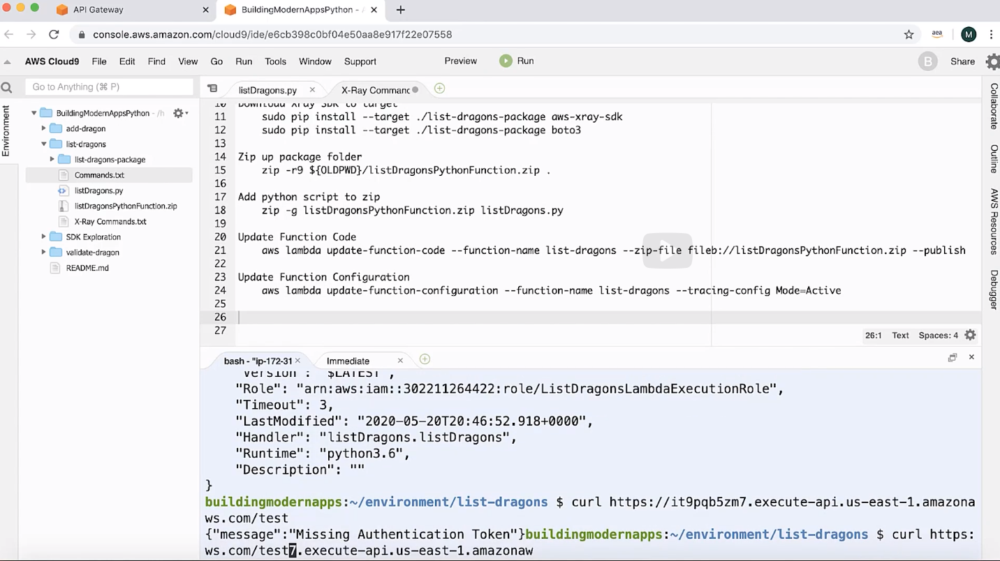
  
But then we also need to include the resource, so /dragons.  
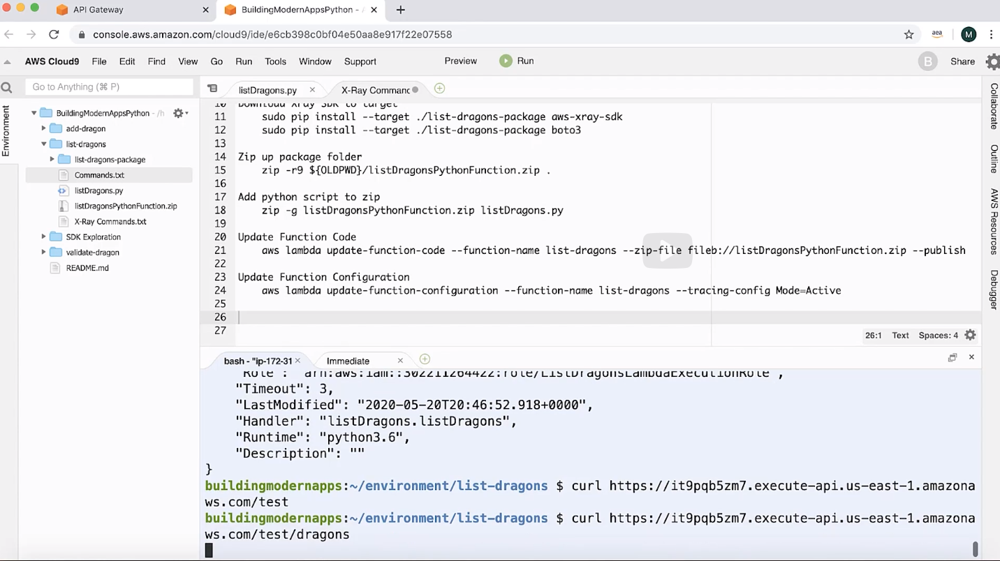
  
There we go. Okay, so we hit our dragon resource, and the dragon resource without providing any query filter, we'll just do a select * on S3 Select and return everything. So this is returning all of the JSON data that we had in that file. So we can see that that did indeed work.  So that's great, we were able to invoke the function through API Gateway.   
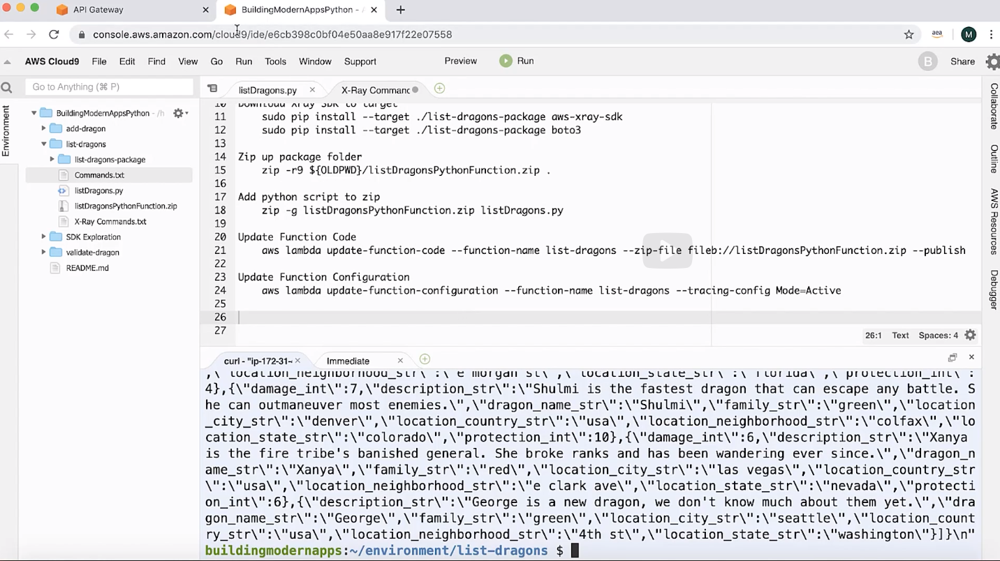
  
Now the real test for this is to make sure that X-Ray was actually capturing. So let's go back to the AWS Console, Services and let's type in X-Ray.   
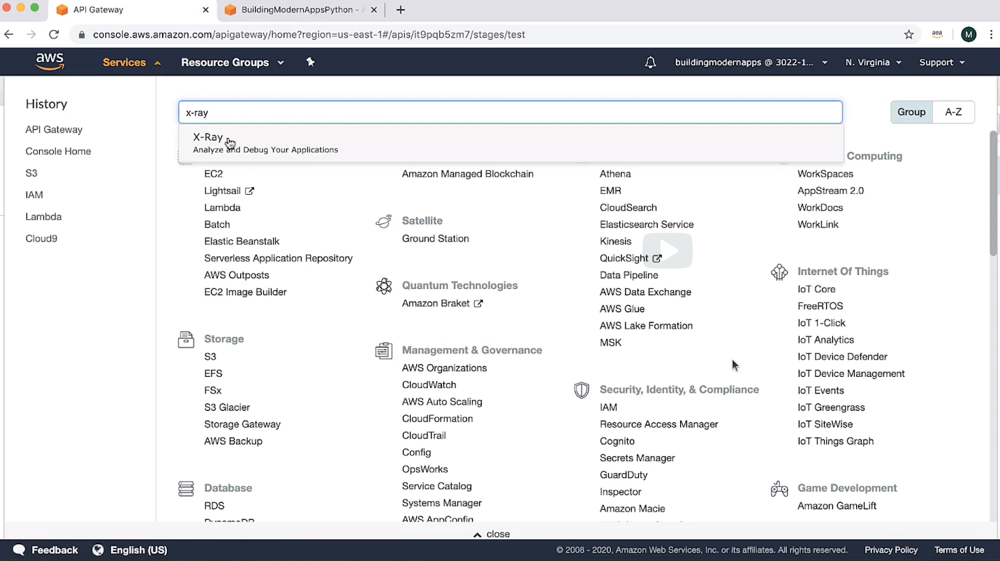
  
Okay, and so you can see right here that we have some information, we have the client coming in, hitting the list-dragons Lambda function, and we're then hitting or the list-dragons Lambda, then we are hitting our list-dragons Lambda function, and that is then reaching out to S3.   
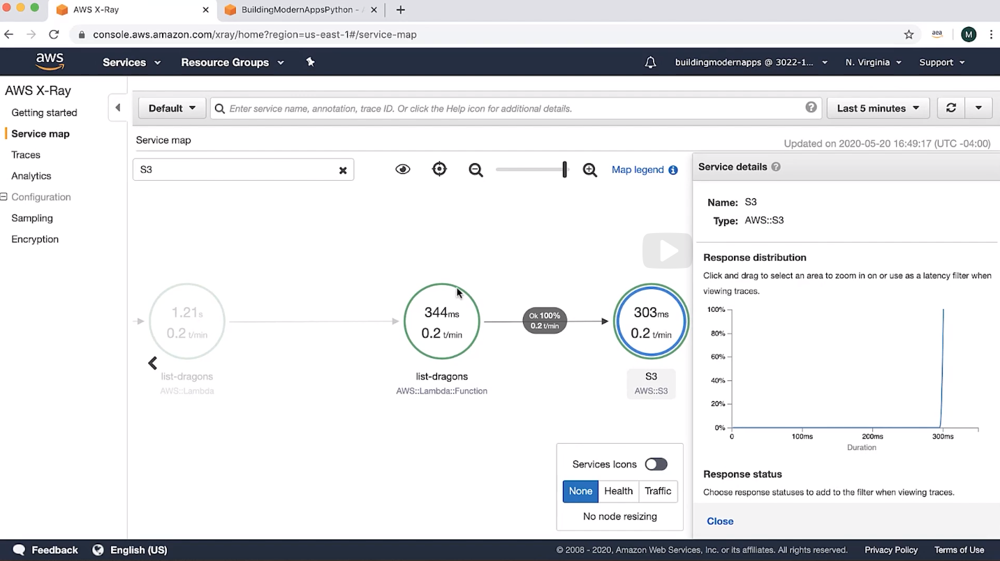
  
So if we go to traces here,  
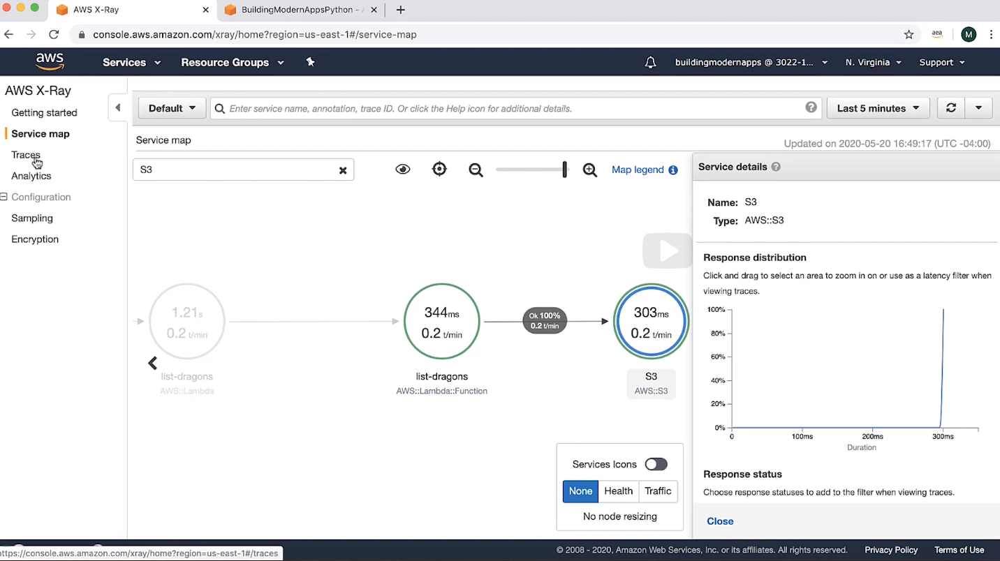
  
and then I click on this specific trace,  
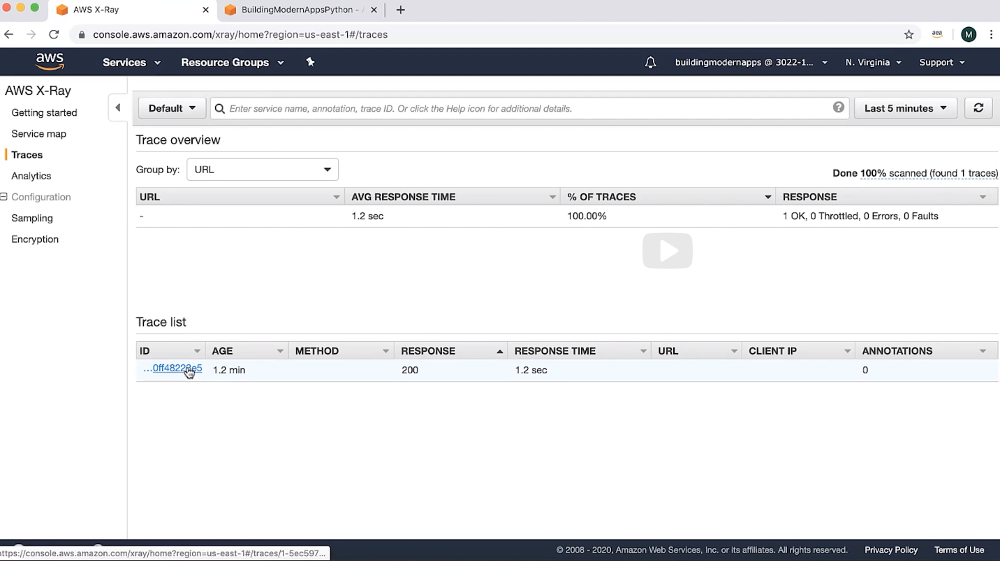
  
I want to look at the data below here.  
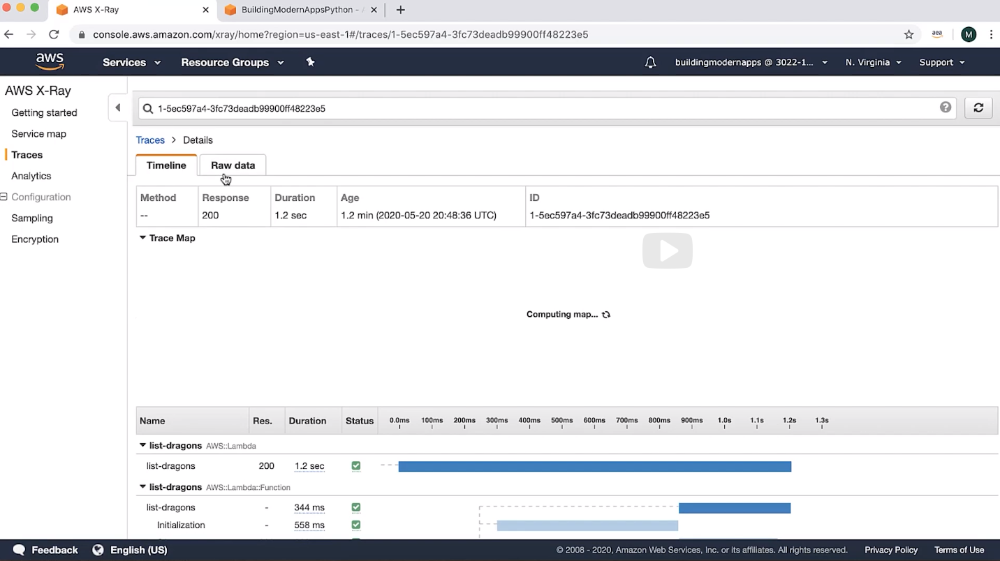
  
So I have the list-dragons function in total took 1.2 seconds to run. Remember that with Lambda functions, the first time you run it is going to be the longest because if you look here, we have all of this initialization set up.  
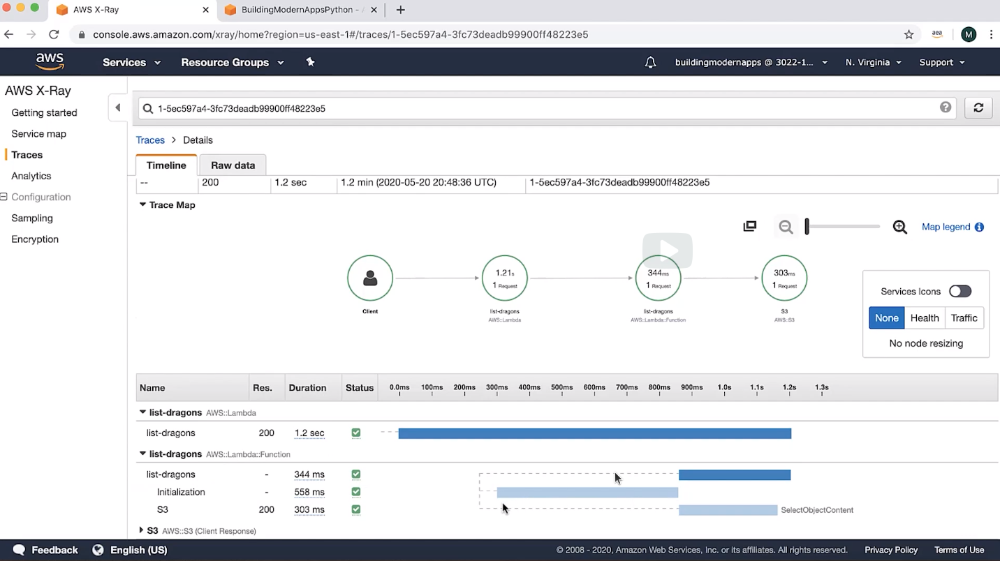
  
With execution context reuse, the second time you run this should theoretically be faster,  so we can take a look at that too. But we're looking here we see the initialization took some time, and then we are have this call to S3, the SelectObjectContent, we can see that took 303 milliseconds. And so that's that, we can see that this is actually recording downstream calls using the AWS SDK. Without using the X-Ray SDK, this part here would not have shown up on this graph because it would not have recorded the downstream requests.  
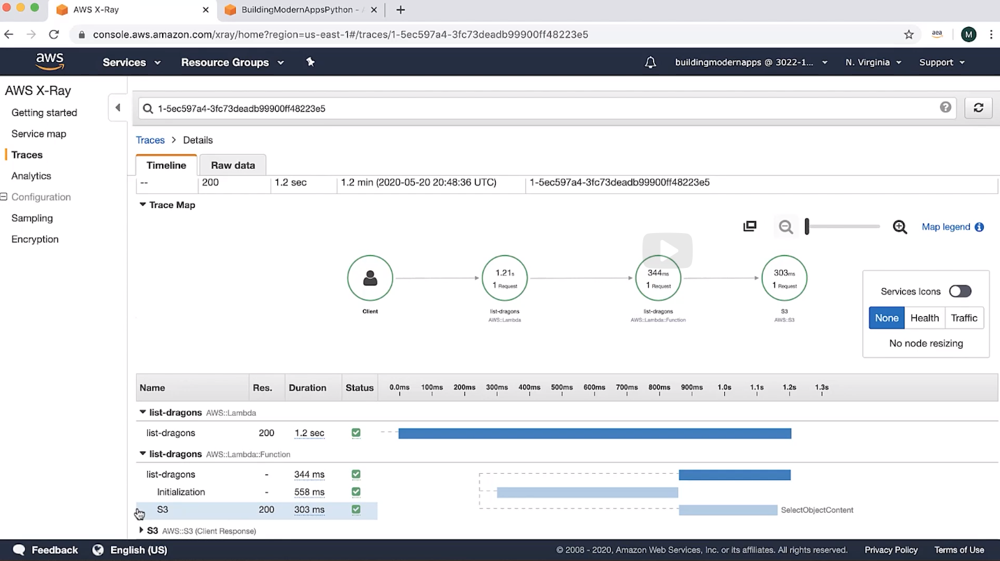
  
If we go to the raw data,   
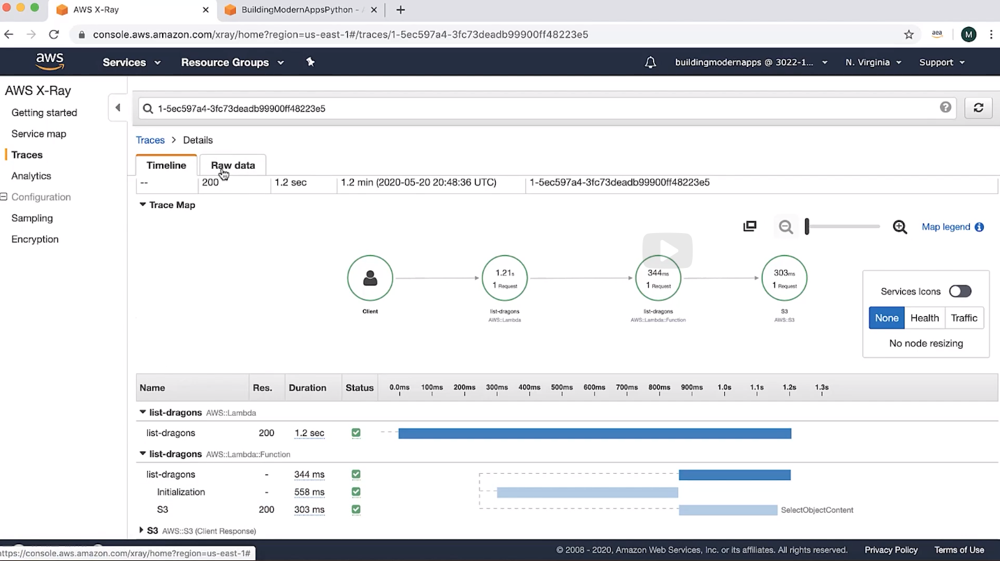
  
you can see your segments. So you see the whole document, you can see your segments here, and all the information about this specific trace. You can see the ARN of the function that was invoked. You can see the origin as well as the subsegments. If you added any metadata, or any annotations, you would see them here in this raw data,  and you also could do the filtering on the filterable aspects of that. Alright, so let's go back to timeline here.   
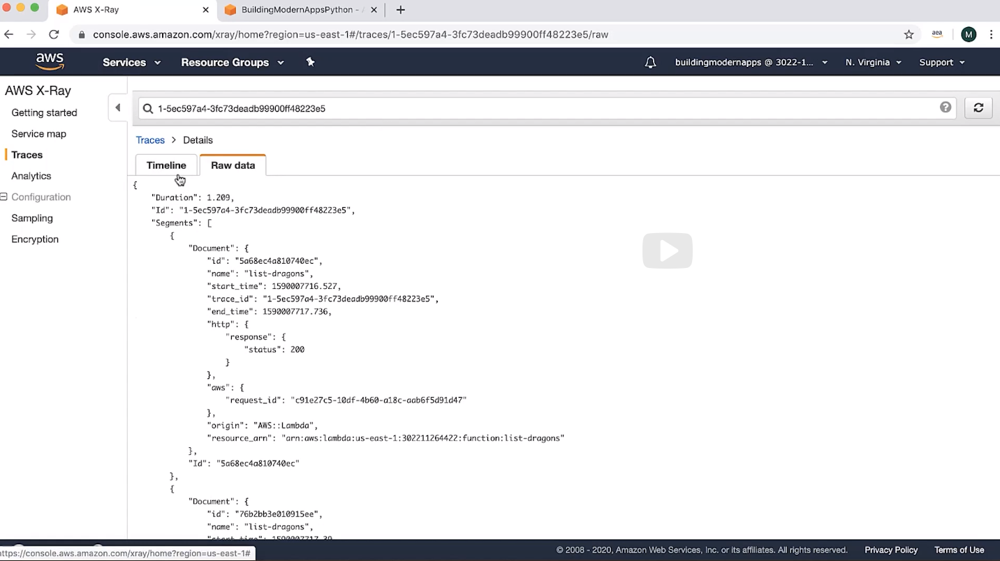
  
And then I want to actually go in and run this one more time. So let's do that.  
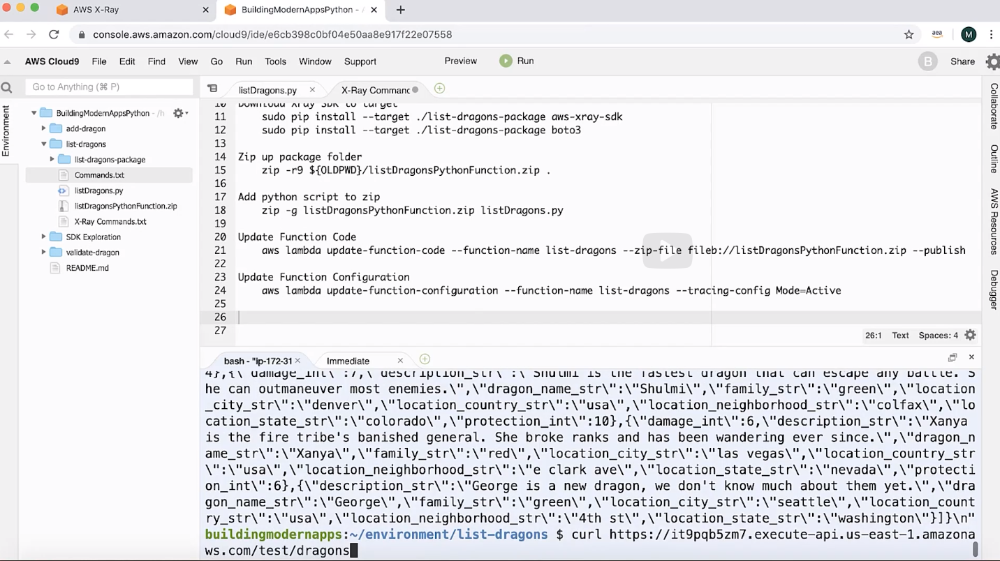
  
Okay, so we can see that the Curl ran again, it responded successfully.  
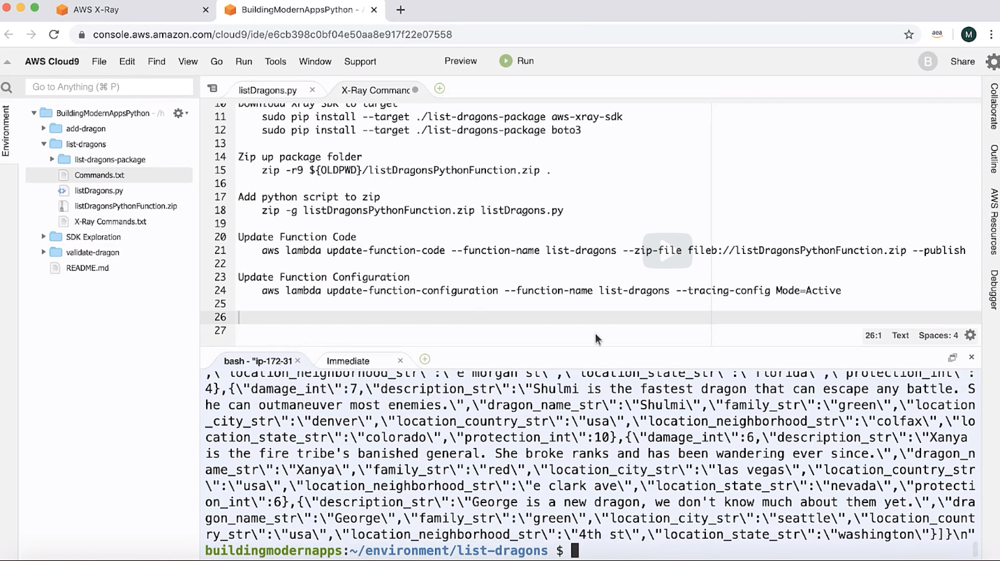
  
Let's go back to X-Ray. Let's refresh it.   
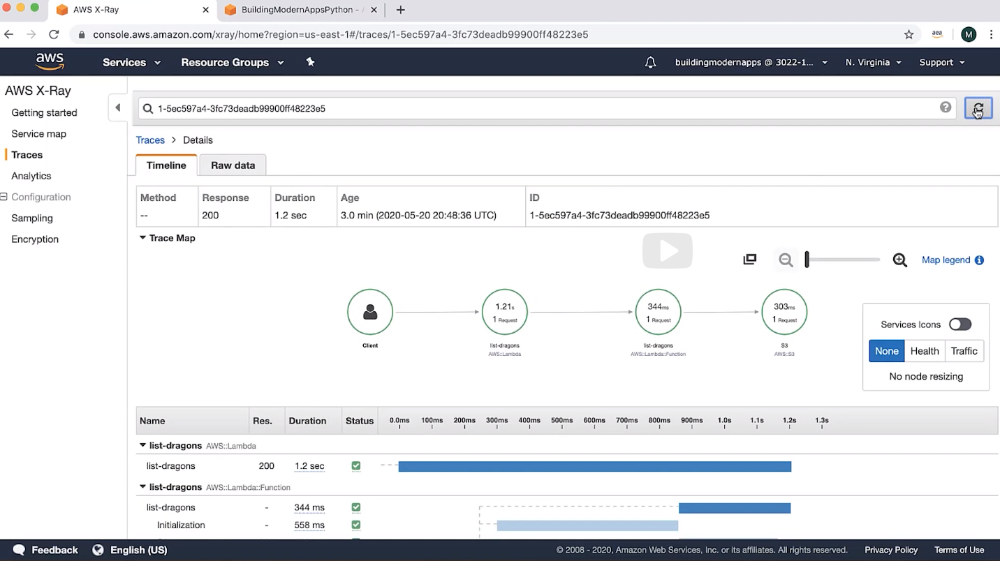
  And then  
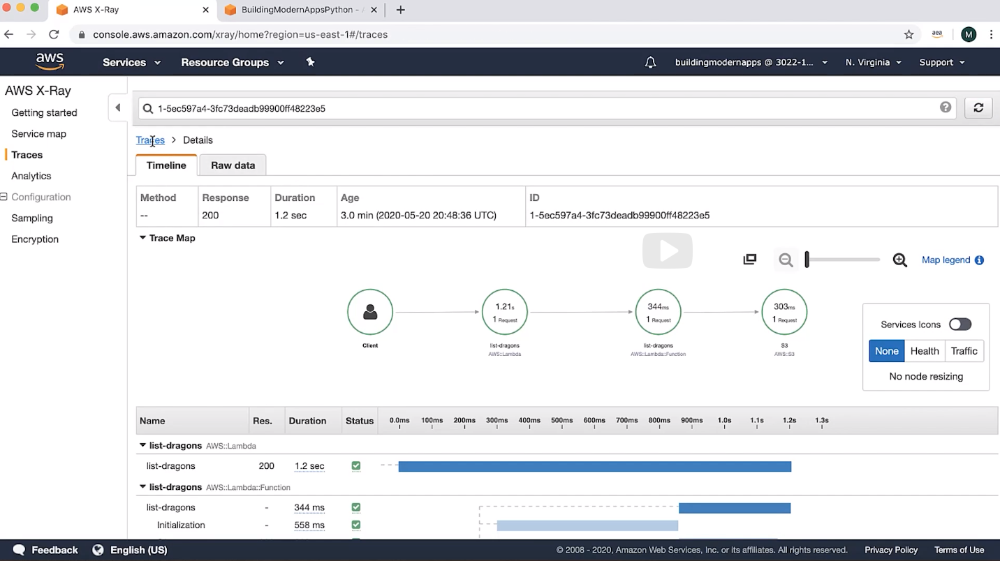
  
Go back to our service map.   
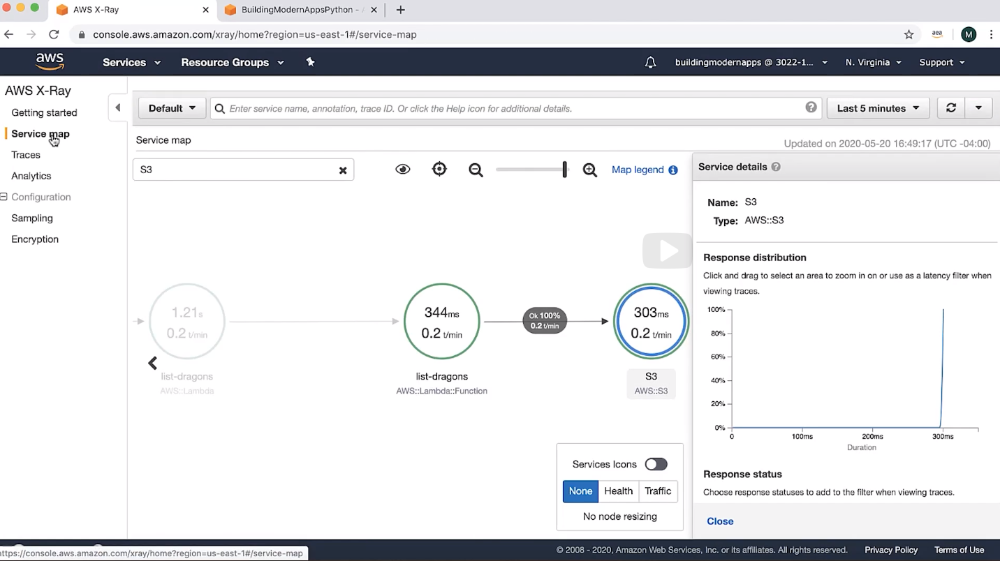
  
Refresh, you can see it says map is updating.  
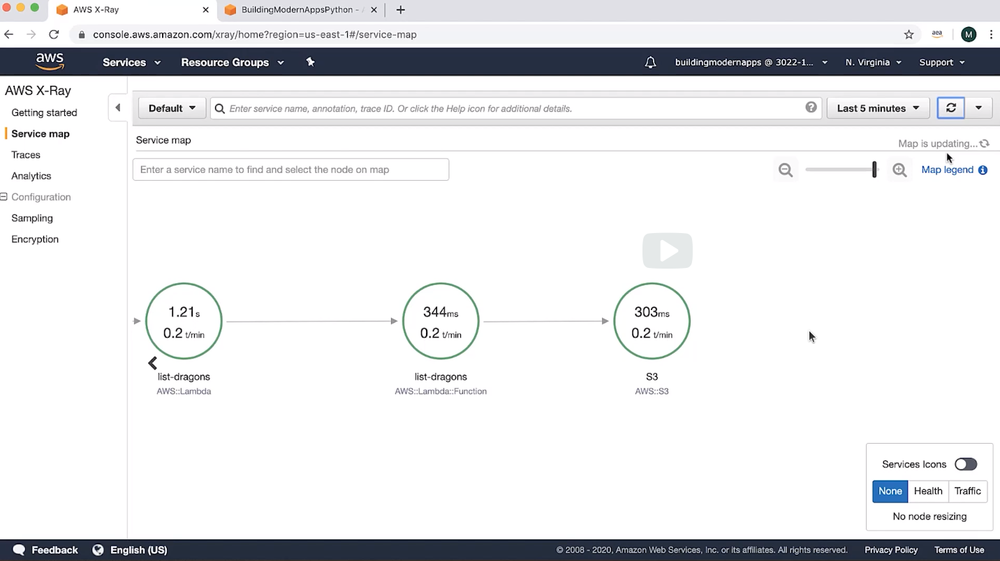
  
Okay, so now we can see   
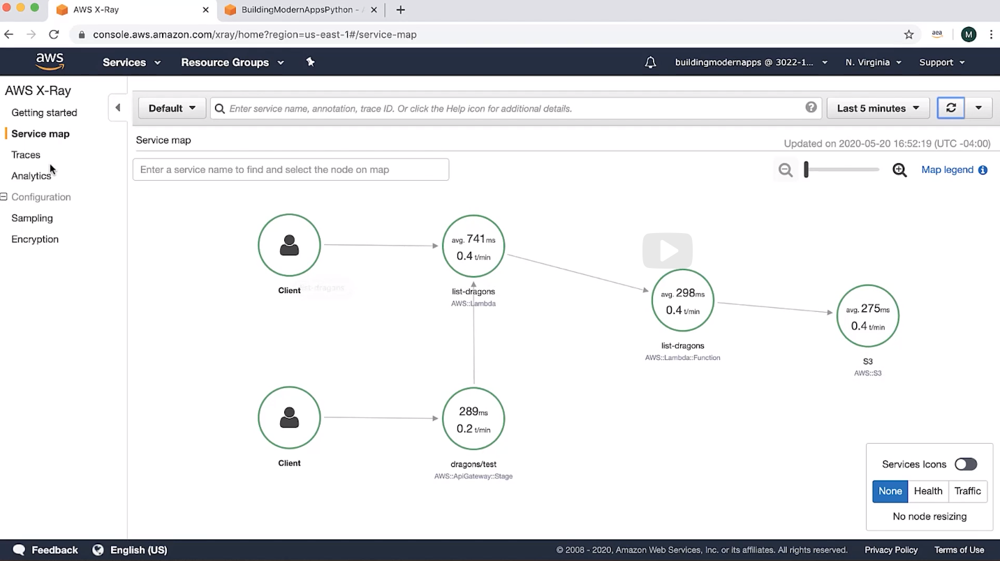
  
that we have another client here coming in hitting API Gateway --that dragons test stage. And then this is then calling the list-dragons Lambda function, which is then executing and calling S3. Let's go back over to traces.   
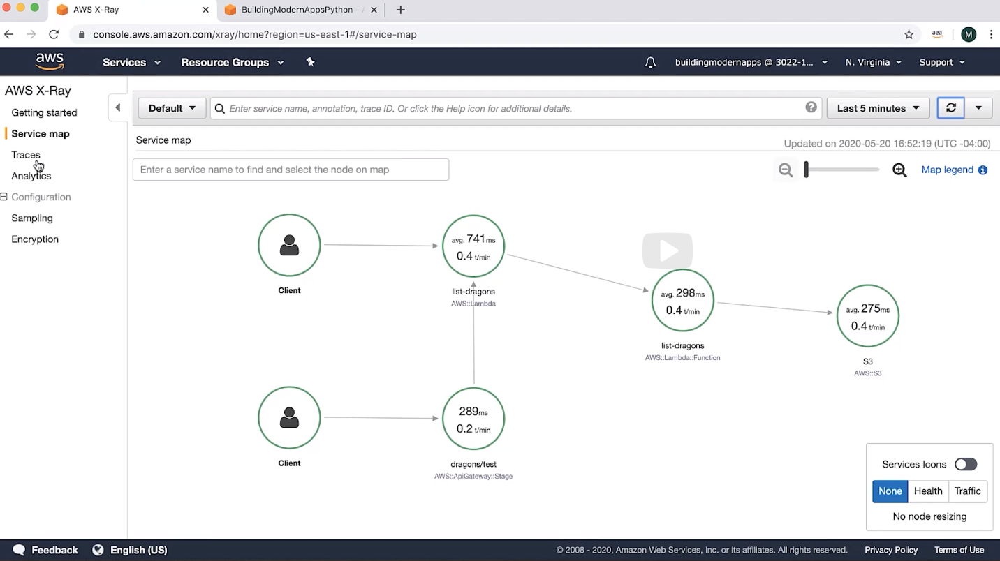
  
And let's change this to be the last 15 minutes.  
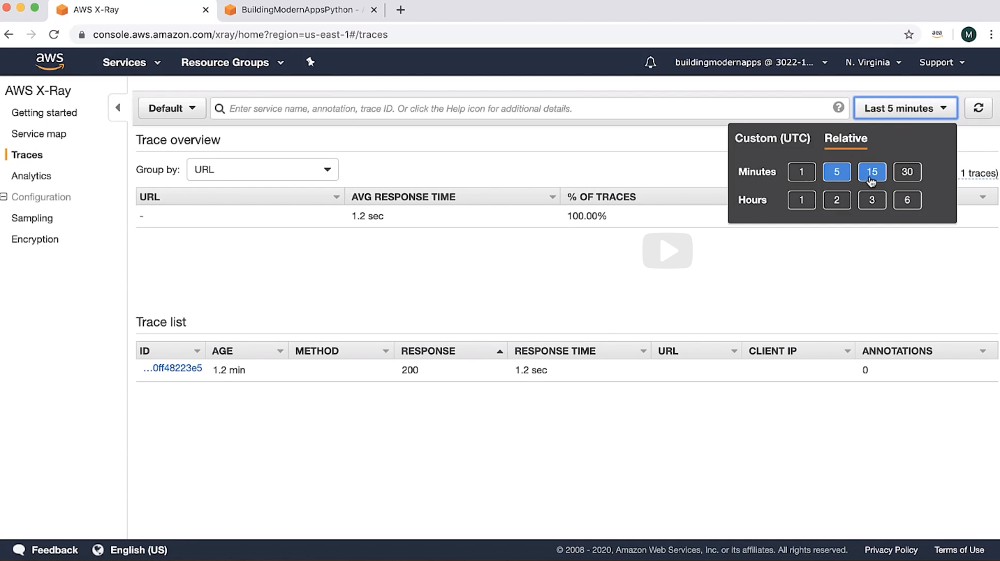
  
So you can see here now that we have two traces   
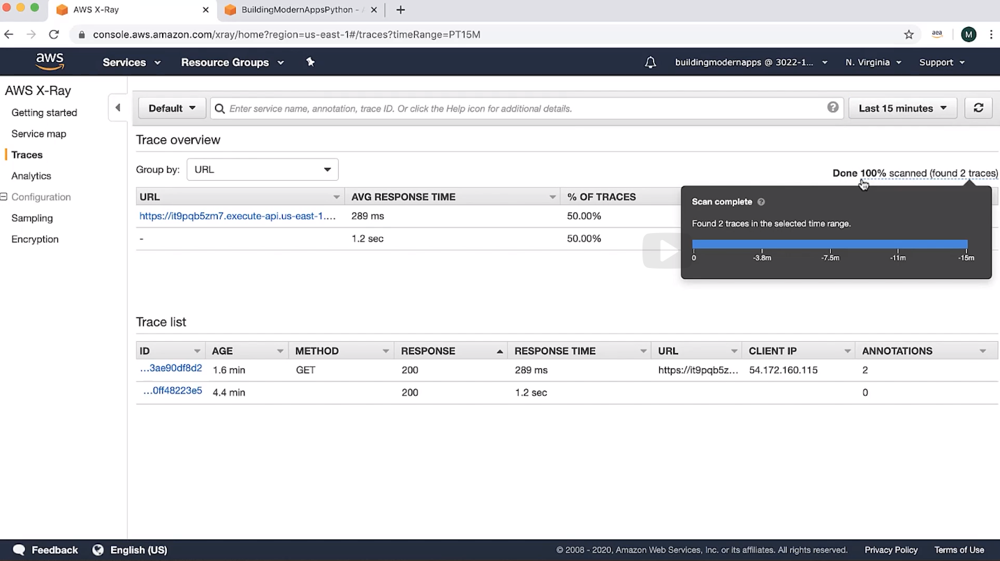
  
that we run, and you can see the first time that we executed this Lambda function, it took 1.2 seconds, and then the second time we executed it, it only took 289 milliseconds. So there was actually a pretty large improvement from the first execution to the second, and again, that's because of that Lambda initialization, it didn't happen the second time.   
  
So let's click on this trace,  
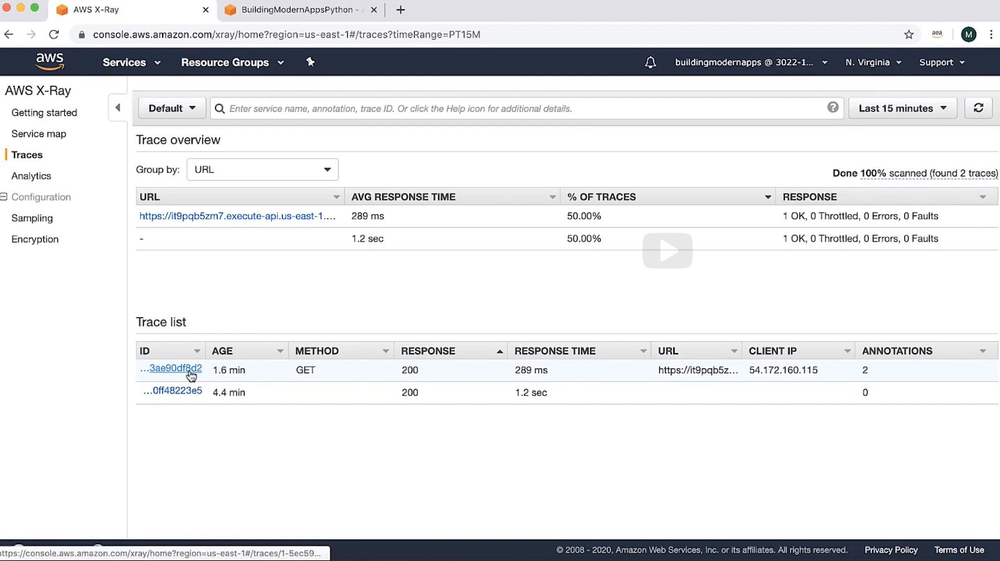
  
and we can see, scroll down, we have this dragons/test came from API Gateway, which executed Lambda, and then our list-dragons function down here, we're calling S3, SelectObjectContent --that's S3 Select.   
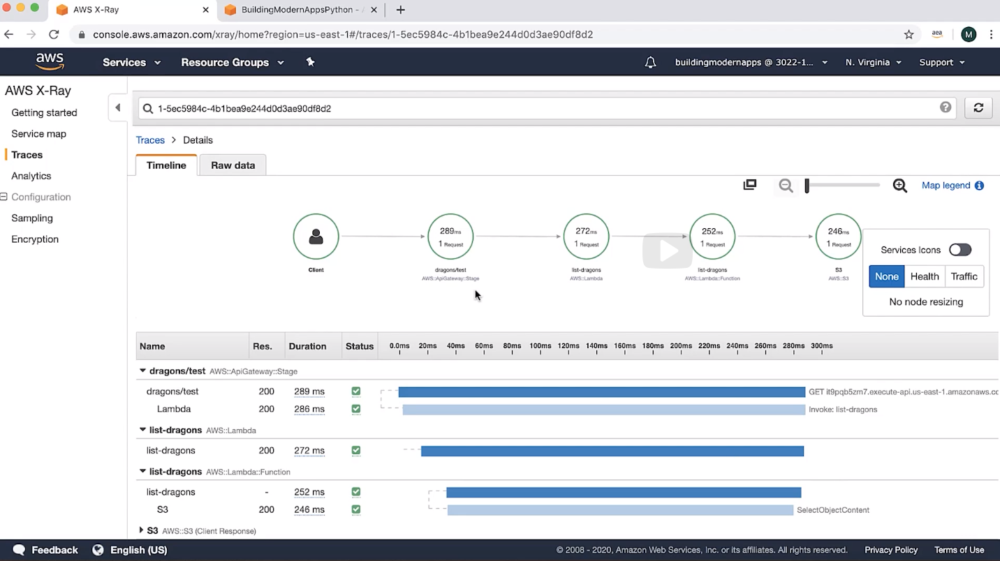
  
Notice we don't have any initialization from the Lambda side. That's execution context reuse. That's why you want to declare things outside of your handler. You can see the proof right here in X-Ray, that does actually help.   
  
So keep that in mind and use X-Ray to your advantage as you tweak things with your Lambda function and you tweak things with API Gateway, you should be able to come in here, and view a history of your traces,  
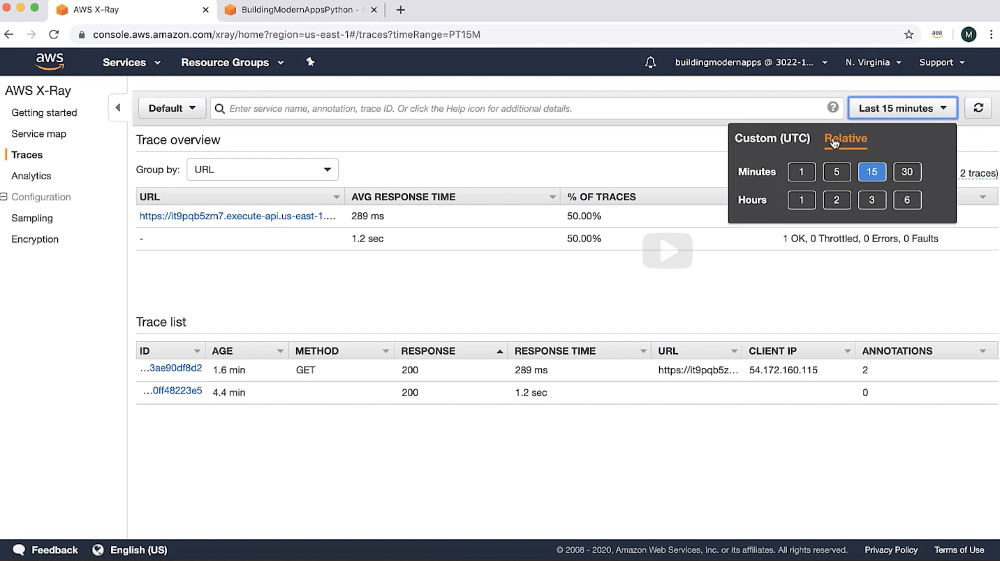
  
and see how they're performing as you've made improvements and optimizations. 

You can see with Python it's fairly easy to enable tracing for your Lambda functions. Remember, if you want to enable tracing from another hosting option, like EC2, you'll need to ensure that the X-Ray daemon is downloaded and installed and running, so the AWS SDK and the X-Ray SDK can interact with it. Check out the class notes for more information on how to download the X-Ray daemon, as well as more information on how to use the X-Ray daemon.

<pre>


    
</pre>
### X-Ray Terminology

### <ins>AWS X-Ray Terminology</ins>

AWS X-Ray is a service that collects data about requests that your application serves, and provides tools you can use to view, filter, and gain insights into that data to identify issues and opportunities for optimization. For any traced request to your application, you can see detailed information not only about the request and response, but also about calls that your application makes to downstream AWS resources, microservices, databases and HTTP web APIs.

For general information on AWS X-Ray click here: https://docs.aws.amazon.com/xray/latest/devguide/aws-xray.html

**Segments**

The compute resources running your application logic send data about their work as segments. A segment provides the resource's name, details about the request, and details about the work done.

**Subsegments**

A segment can break down the data about the work done into subsegments. Subsegments provide more granular timing information and details about downstream calls that your application made to fulfill the original request. A subsegment can contain additional details about a call to an AWS service, an external HTTP API, or an SQL database. You can even define arbitrary subsegments to instrument specific functions or lines of code in your application.

**Service graph**

X-Ray uses the data that your application sends to generate a service graph. Each AWS resource that sends data to X-Ray appears as a service in the graph. Edges connect the services that work together to serve requests. Edges connect clients to your application, and your application to the downstream services and resources that it uses.

**Traces**

A trace ID tracks the path of a request through your application. A trace collects all the segments generated by a single request. That request is typically an HTTP GET or POST request that travels through a load balancer, hits your application code, and generates downstream calls to other AWS services or external web APIs. The first supported service that the HTTP request interacts with adds a trace ID header to the request, and propagates it downstream to track the latency, disposition, and other request data.

**Annotations and metadata**

When you instrument your application, the X-Ray SDK records information about incoming and outgoing requests, the AWS resources used, and the application itself. You can add other information to the segment document as annotations and metadata. Annotations and metadata are aggregated at the trace level, and can be added to any segment or subsegment.

**Annotations** are simple key-value pairs that are indexed for use with filter expressions. Use annotations to record data that you want to use to group traces in the console, or when calling the GetTraceSummaries API.

X-Ray indexes up to 50 annotations per trace.

**Metadata** are key-value pairs with values of any type, including objects and lists, but that are not indexed. Use metadata to record data you want to store in the trace but don't need to use for searching traces.

### <ins>The X-Ray Daemon</ins>

The AWS X-Ray daemon is a software application that listens for traffic on UDP port 2000, gathers raw segment data, and relays it to the AWS X-Ray API. The daemon works in conjunction with the AWS X-Ray SDKs and must be running so that data sent by the SDKs can reach the X-Ray service.

When using AWS X-Ray, your code isn’t uploading traced directly to the X-Ray service. Instead, it sends information to the X-Ray Daemon which then uploads the information in batches to the X-Ray service.

If you are running code on AWS Lambda, the X-ray Daemon is installed and managed for you. You can simply just start using the X-Ray SDK. If you are running X-ray outside of Lambda you may need to install and manage the daemon yourself. Read more information about how to install and setup the X-ray Daemon at: https://docs.aws.amazon.com/xray/latest/devguide/xray-daemon.html

### <ins>How to use X-Ray in Python Applications</ins>
The X-Ray SDK for Python is a library for Python web applications that provides classes and methods for generating and sending trace data to the X-Ray daemon. Trace data includes information about incoming HTTP requests served by the application, and calls that the application makes to downstream services using the AWS SDK, HTTP clients, or an SQL database connector. You can also create segments manually and add debug information in annotations and metadata.

For more information on the AWS X-Ray SDK for Python click here:   
https://docs.aws.amazon.com/xray/latest/devguide/xray-sdk-python.html